# **Projet Analyse de données : Velib Stations Paris - Notebook secondaire**

---
_Authors:_ Tom Brusseaux, Maïmouna Gadji,Natael Régnier, Tidiane Sall

Dans ce projet, nous explorons le jeu de données Velib, relatif au système de partage de vélos de Paris. Ces données fournissent les profils de chargement des stations de vélos sur une semaine, enregistrés chaque heure du lundi 2 septembre au dimanche 7 septembre 2014. Chaque profil de chargement représente le rapport entre le nombre de vélos disponibles et le nombre total de bornes de vélos dans une station à un moment donné. Un chargement de 1 indique une station pleinement chargée (tous les vélos sont disponibles), tandis qu'un chargement de 0 signifie qu'elle est vide (tous les vélos ont été loués).

Dans cette étude, chaque station de vélo est considérée comme un individu, et les 168 tranches horaires de la semaine sont les variables. Notre objectif principal est de découvrir des regroupements dans les données, révélant des modèles d'utilisation similaires des clients. Ces regroupements serviront ensuite à prédire les profils de chargement des différentes stations de vélos.

**On importe les librairies nécessaires au projet :**

In [409]:
library(ggplot2)
library(reshape2)
library(gridExtra)

**On importe les données correspondantes au projet :**

In [410]:
load('velib.Rdata')
summary(velib)

         Length Class      Mode     
data      181   data.frame list     
position    2   data.frame list     
dates     181   -none-     character
bonus    1189   -none-     numeric  
names    1189   -none-     character

## **1. Traitement des données**

**On sépare notre jeu de données en "loading" et "coord". "loading" correspond au chargement des stations de vélib dans Paris par heure et "coord" correspond aux coordonnées (longitude-latitude) des stations de velib et on a aussi la variable "bonus" qui détermine si la station est située sur une colline ou non.**

In [411]:
# data preparation
loading = as.matrix(velib$data)
colnames(loading) = 1:ncol(loading)
rownames(loading) = velib$names

stations = 1:nrow(loading)
coord = velib$position[stations,]
coord$bonus = velib$bonus[stations]


**Pour notre projet, nous allons sélectionner uniquement 7 jours de données (1 semaine) :**

In [412]:
dates = 14:181
loading = loading[stations, dates]
colnames(loading) = 1:length(dates)

**On constate que les coordonnées des stations dupliquées sont très proches mais pas identiques. On va donc considérer que ce sont des stations différentes et donc garder loading.**

In [413]:
#loading_pas_duplique <- loading[!duplicated(rownames(loading)), ]

**Pour permettre une analyse plus profonde, on va aussi noter "loading_with_coord" la variable qui fusionne "coord" et "loading".**

In [414]:
loading_with_coord <- cbind(loading, coord)

## 2. **Analyse descriptive du chargement des stations**

**Premièrement, voici une première vu de notre jeu de donnée "loading".**

In [415]:
head(loading)

,1,2,3,4,5,6,7,8,9,10,⋯,159,160,161,162,163,164,165,166,167,168
EURYALE DEHAYNIN,0.03846154,0.03846154,0.07692308,0.03846154,0.03846154,0.03846154,0.03846154,0.03846154,0.10714286,0.00000000,⋯,0.29629630,0.11111111,0.1111111,0.14814815,0.30769231,0.07692308,0.11538462,0.07692308,0.1538462,0.1538462
LEMERCIER,0.47826087,0.47826087,0.47826087,0.43478261,0.43478261,0.43478261,0.43478261,0.43478261,0.26086957,0.04347826,⋯,0.04347826,0.00000000,0.2173913,0.13043478,0.04545455,0.17391304,0.17391304,0.17391304,0.2608696,0.3913043
MEZIERES RENNES,0.21818182,0.14545455,0.12727273,0.10909091,0.10909091,0.10909091,0.09090909,0.09090909,0.05454545,0.10909091,⋯,0.25925926,0.25925926,0.2037037,0.12962963,0.14814815,0.29629630,0.31481481,0.37037037,0.3703704,0.4074074
FARMAN,0.95238095,0.95238095,0.95238095,0.95238095,0.95238095,0.95238095,0.95238095,1.00000000,1.00000000,1.00000000,⋯,1.00000000,1.00000000,0.9047619,0.85714286,0.85714286,0.85714286,0.76190476,0.76190476,0.7619048,0.7619048
QUAI DE LA RAPEE,0.92753623,0.81159420,0.73913043,0.72463768,0.72463768,0.72463768,0.72463768,0.72463768,0.75362319,0.97101449,⋯,0.22727273,0.45454545,0.5909091,0.83333333,1.00000000,0.81818182,0.63636364,0.71212121,0.6212121,0.5757576
CHOISY POINT D'IVRY,0.16666667,0.16666667,0.16666667,0.16666667,0.16666667,0.16666667,0.16666667,0.16666667,0.08333333,0.00000000,⋯,0.34782609,0.08695652,0.1153846,0.08695652,0.13043478,0.08695652,0.08695652,0.43478261,0.3913043,0.5217391


**On peut observer le chargement des stations heure par heure sur toute la semaine :**

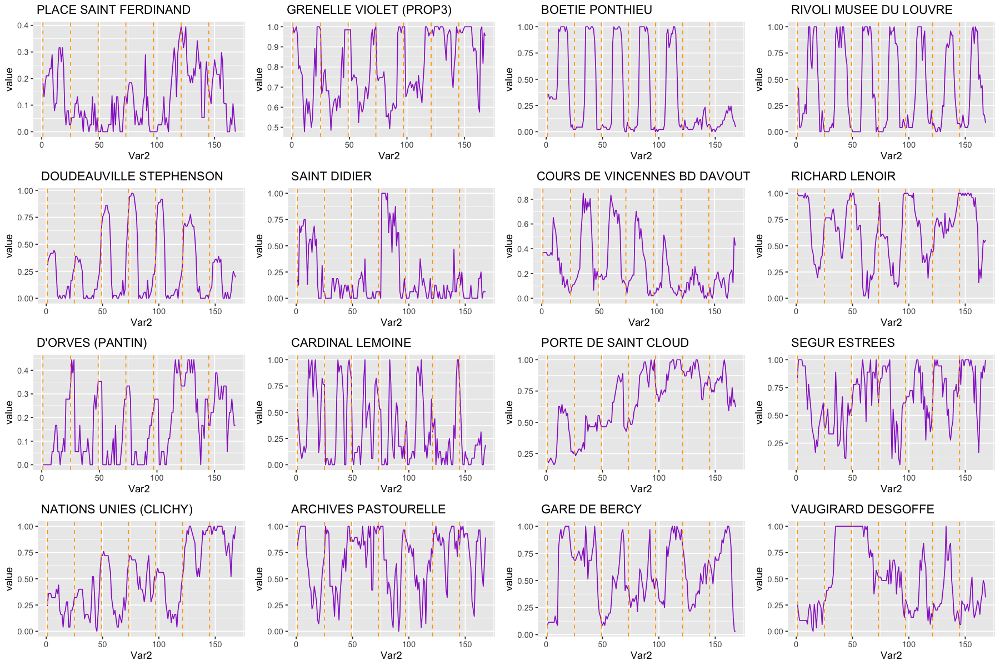

In [416]:
options(repr.plot.width = 15, repr.plot.height = 10)

# --- #

timeTick = 1 + 24*(0:6)  # vector corresponding to the beginning of days

# select 16 stations
stations = sample.int(nrow(loading), 16 , replace=TRUE)

df = melt(loading[stations,])  #the function melt reshapes it from wide to long

p = list()
for (i in 1:16){
    dfi = df[df$Var1 == velib$names[stations[i]],]
    p[[i]] = ggplot(dfi, aes(x=Var2, y=value)) + 
        geom_line(col="darkorchid") + 
        geom_vline(xintercept=timeTick, col="orange", linetype="dashed") +
        labs(title=velib$names[stations[i]])
}
do.call(grid.arrange,p)

**L'analyse montre une périodicité quotidienne dans la distribution des vélos entre les stations, caractérisée par différents modèles de chargement et de déchargement. Certaines stations affichent des niveaux de chargement élevés autour de minuit et se déchargent vers midi, suggérant une migration quotidienne des vélos d'une partie de la ville à une autre. En outre, il existe des variations notables entre les jours de semaine et les week-ends, ainsi qu'entre les différentes villes.**

**La périodicité d'un jour est commune à la majorité des stations, mais des différences significatives apparaissent dans les profils de chargement selon les heures et les jours. Par exemple, durant les heures tardives (de 0h à 4h), l'usage des vélos diminue, ce qui entraîne des taux de chargement plus élevés pendant ces heures. Ces observations soulignent la complexité des dynamiques urbaines et la nécessité de stratégies adaptées pour la gestion des flux de vélos.**

**Nous pouvons aussi observer le boxplot pour chaque variable de "loading", c'est-à-dire, pour toutes les heures :**

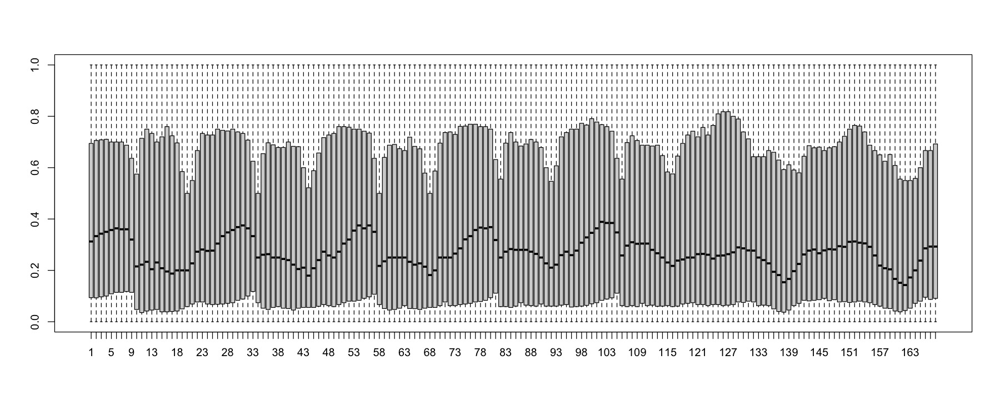

In [417]:
options(repr.plot.width = 15, repr.plot.height = 6)

boxplot(loading)

**On observe une une alternance de rechargement / déchargement : en semaine le déchargement s'effectue vers midi et en week-end le déchargement s'effectue en soirée.**

**Il est aussi intéressant d'observer le chargement moyen pour toutes les stations à toutes les heures.**

In [418]:
print('--- Average fill rate ---')
mean(loading)

[1] "--- Average fill rate ---"


[1] 0.3816218

**On observe donc un chargement moyen de 38%. En moyenne, il y a 62% des vélos qui sont utilisés en permanence.**

**Dans la même idée, nous pouvons aussi déterminer quelles stations sont en moyenne les moins chargées et les plus chargées :**

In [419]:
print('')
means = list()
for (i in 1:length(loading[,1]))
    {
    means[i] = mean(loading[i,])
     }
indice_min = which.min(means)
indice_max = which.max(means)

print('--- Least crowded station, on average ---')
print(velib$names[indice_min])

# --- #
print('')

print('--- Fullest station, on average ---')
print(velib$names[indice_max])


[1] ""
[1] "--- Least crowded station, on average ---"
[1] " HORNET (BAGNOLET)"
[1] ""
[1] "--- Fullest station, on average ---"
[1] " INSURRECTION AOUT 1944 (IVRY)"


**On observe donc que la station la moins chargée en moyenne est "Hornet (Bagnolet)". Cela est probablement dû au fait qu'elle soit excentrée.**

**La station la plus chargée en moyenne est "Insurrection août 1944 (Ivry)". Cela est cohérent, car comme nous le verrons après cette station est située près de la Seine).**

**Il peut être aussi intéressant d'observer le chargement moyen des stations par jour.**

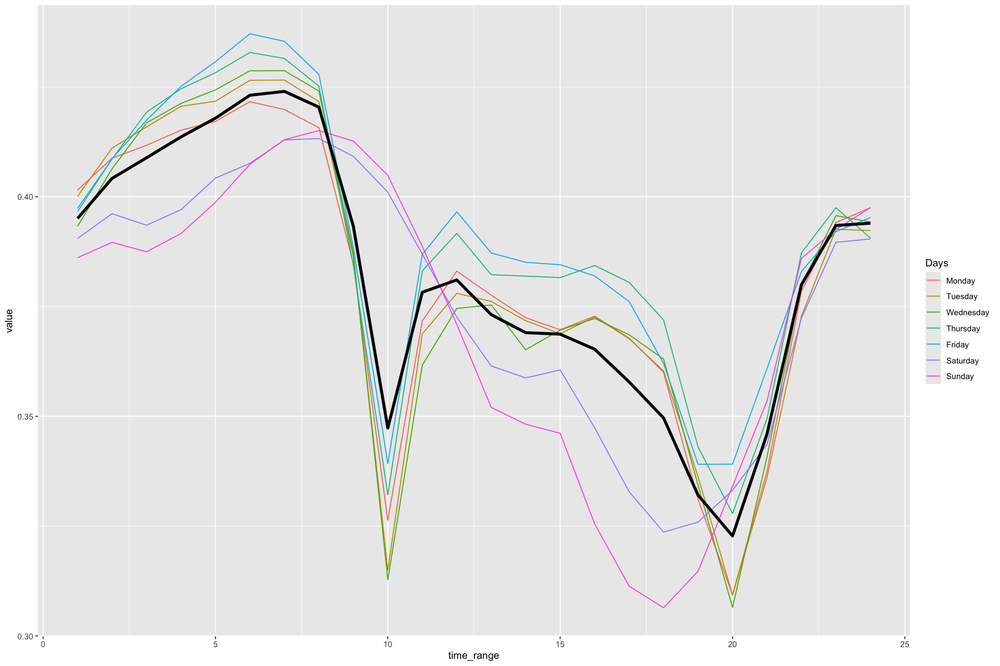

In [420]:
mean_per_hour_per_day = colMeans(loading)
mean_per_hour_per_day = matrix(mean_per_hour_per_day, nrow = 24)
mean_per_hour         = rowMeans(mean_per_hour_per_day)

# --- #

mean_per_hour_per_day            = as.data.frame(mean_per_hour_per_day)
colnames(mean_per_hour_per_day)  = list("Monday", "Tuesday", "Wednesday","Thursday", "Friday", "Saturday", "Sunday")
mean_per_hour_per_day$time_range = c(1:24)
mean_per_hour_per_day            = melt(mean_per_hour_per_day, id='time_range', variable.name='Days')

mean_per_hour            = as.data.frame(mean_per_hour)
colnames(mean_per_hour)  = list("Weekly")
mean_per_hour$time_range = c(1:24)

# --- #

options(repr.plot.width = 15, repr.plot.height = 10)

ggplot() + 
    geom_line(data=mean_per_hour_per_day, aes(x=time_range, y=value, color=Days)) + 
    geom_line(data=mean_per_hour, aes(x=time_range, y=Weekly), linewidth = 1.5)


**L'analyse des données révèle un comportement distinct entre les jours de semaine et les week-ends en termes de chargement et déchargement des vélos aux stations. En semaine, on observe un grand déchargement le matin jusqu'à 10h suivi d'un rechargement progressif, avec un pic de déchargement vers 20h, probablement dû aux déplacements pendulaires des travailleurs. En contraste, pendant le week-end, le déchargement est plus étalé, se prolongeant jusqu'à 18h, lié à des activités de loisirs en soirée, suivi par un rechargement dans la nuit, à mesure que les gens rentrent chez eux.**

**Les boxplots et les courbes de tendance confirment la périodicité journalière du chargement, avec des stations généralement moins chargées en semaine et durant la nuit. Une similarité est observée entre les courbes des jours ouvrés et celles du week-end. Pendant la semaine, les emprunts de vélos sont concentrés autour de 8h et 19h, correspondant aux trajets domicile-travail. Les weekends, les emprunts augmentent plutôt en fin d'après-midi vers 17h, suggérant des sorties de détente ou de promenade. Ces motifs d'utilisation soulignent les rythmes de vie urbains et la variabilité des besoins en transport selon les jours.**

**Faisons une visualisation du chargement moyen de chaque gare placée sur la carte de Paris :**

**Pour 6h 12h et 23h :**

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.



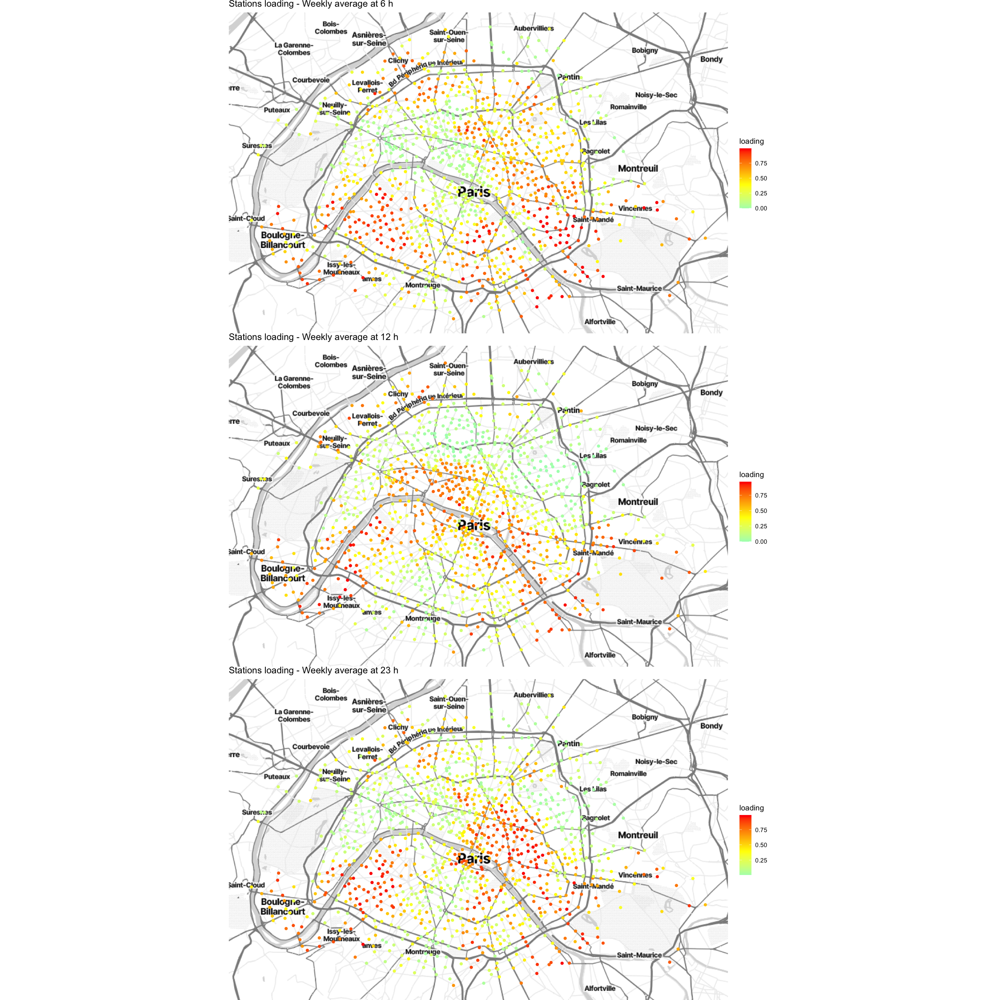

In [421]:
library(ggmap)

ggmap::register_stadiamaps(key = "f5428ead-0f2c-4508-bd37-50d807a861ca")

moyenne_loading <- rowMeans(loading, na.rm = TRUE)
# Hours to be displayed
h     = 6
hours = seq(h, 168, 24)
load_per_hour = rowMeans(loading[, hours])

df = coord
df$loading = load_per_hour

# --- #

options(repr.plot.width = 10, repr.plot.height = 10)

# Utilisez scale_color_gradient2 pour spécifier les couleurs de début et de fin
p1 = qmplot(data = df, longitude, latitude, color = loading)  +
labs(title = paste('Stations loading - Weekly average at',h,'h')) +
   scale_color_gradient2(low = "cyan",mid="yellow" ,  high = "red", midpoint = mean(loading))



h     = 12
hours = seq(h, 168, 24)
load_per_hour = rowMeans(loading[, hours])

df = coord
df$loading = load_per_hour

# --- #

options(repr.plot.width = 10, repr.plot.height = 10)

# Utilisez scale_color_gradient2 pour spécifier les couleurs de début et de fin
p2 = qmplot(data = df, longitude, latitude, color = loading) +
  labs(title = paste('Stations loading - Weekly average at',h,'h')) +
  scale_color_gradient2(low = "cyan",mid="yellow" ,  high = "red", midpoint = mean(loading))


h     = 23
hours = seq(h, 168, 24)
load_per_hour = rowMeans(loading[, hours])

df = coord
df$loading = load_per_hour

# --- #

options(repr.plot.width = 10, repr.plot.height = 10)

# Utilisez scale_color_gradient2 pour spécifier les couleurs de début et de fin
p3 = qmplot(data = df, longitude, latitude, color = loading) +
  labs(title = paste('Stations loading - Weekly average at',h,'h')) +
  scale_color_gradient2(low = "cyan",mid="yellow" ,  high = "red", midpoint = mean(loading))



options(repr.plot.width = 20, repr.plot.height = 20)
grid.arrange(p1, p2,p3)




 **Zones à fort chargement (rouge) : Les points rouges, indiquant un niveau de chargement élevé (0.75 sur l'échelle), sont abondants et se concentrent principalement dans le centre de Paris. Cela pourrait indiquer que les stations centrales de Paris sont très utilisées et souvent proches de leur capacité maximale de vélos disponibles. La demande pour les vélos dans ces zones est probablement plus élevée en raison de la densité de population, de l'attrait touristique et des pôles d'emploi, conduisant à un usage fréquent des vélos pour les déplacements courts.**

 **Zones à chargement moyen (jaune) : Les points jaunes montrent un niveau de chargement moyen (autour de 0.50 sur l'échelle), qui sont dispersés autour du centre de Paris et dans certains quartiers périphériques. Ces zones pourraient représenter des stations qui sont régulièrement utilisées mais qui ne sont pas aussi sollicitées que celles du centre-ville. Cela pourrait aussi indiquer des zones résidentielles ou des pôles d'activités secondaires.**

 **Zones à faible chargement (vert) : Les points verts, représentant un faible niveau de chargement (0.25 sur l'échelle), semblent être moins nombreux et éparpillés, possiblement dans des zones périphériques ou moins denses. Ces stations peuvent être moins utilisées soit parce qu'elles sont situées dans des zones avec une demande plus faible de transport en vélo, soit parce qu'elles sont dans des zones avec de bonnes alternatives de transport en commun ou moins accessibles pour les déplacements en vélo.**

 **Il semble y avoir une tendance de convergence vers le centre de Paris à partir de la périphérie entre 6h et 12h, suivie d'un mouvement inverse vers 23h.**

**On constate ainsi que les stations les plus chargées sont autour le long de la Seine et les moins chargées en périphérie de Paris (comme nous pouvons le voir sur le graphique suivant qui représente le chargement moyen sur toute la semaine).**

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.



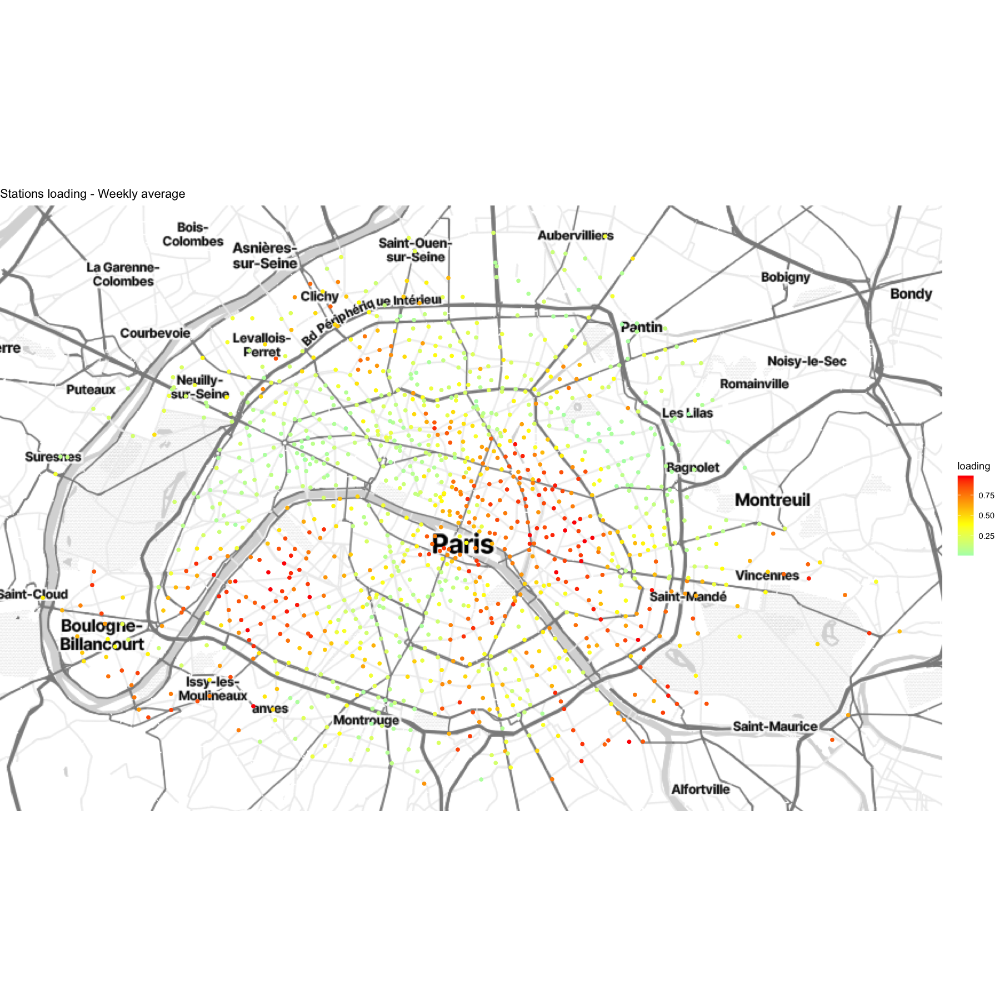

In [422]:
p5 = qmplot(data = df, longitude, latitude, color = loading) +
  labs(title = 'Stations loading - Weekly average') +
  scale_color_gradient2(low = "cyan", mid = "yellow", high = "red", midpoint = mean(moyenne_loading))
options(repr.plot.width = 15, repr.plot.height = 15)
p5

## **3. Analyse en composantes principales de "loading"**

**Nous allons maintenant procéder à une Analyse en Composantes Principales (ACP) afin d'explorer les relations entre les variables de notre dataset et de visualiser les principales tendances et groupes sous-jacents. Cette technique nous aidera à comprendre les structures de variance dans nos données et à simplifier la complexité des informations en réduisant les dimensions.**

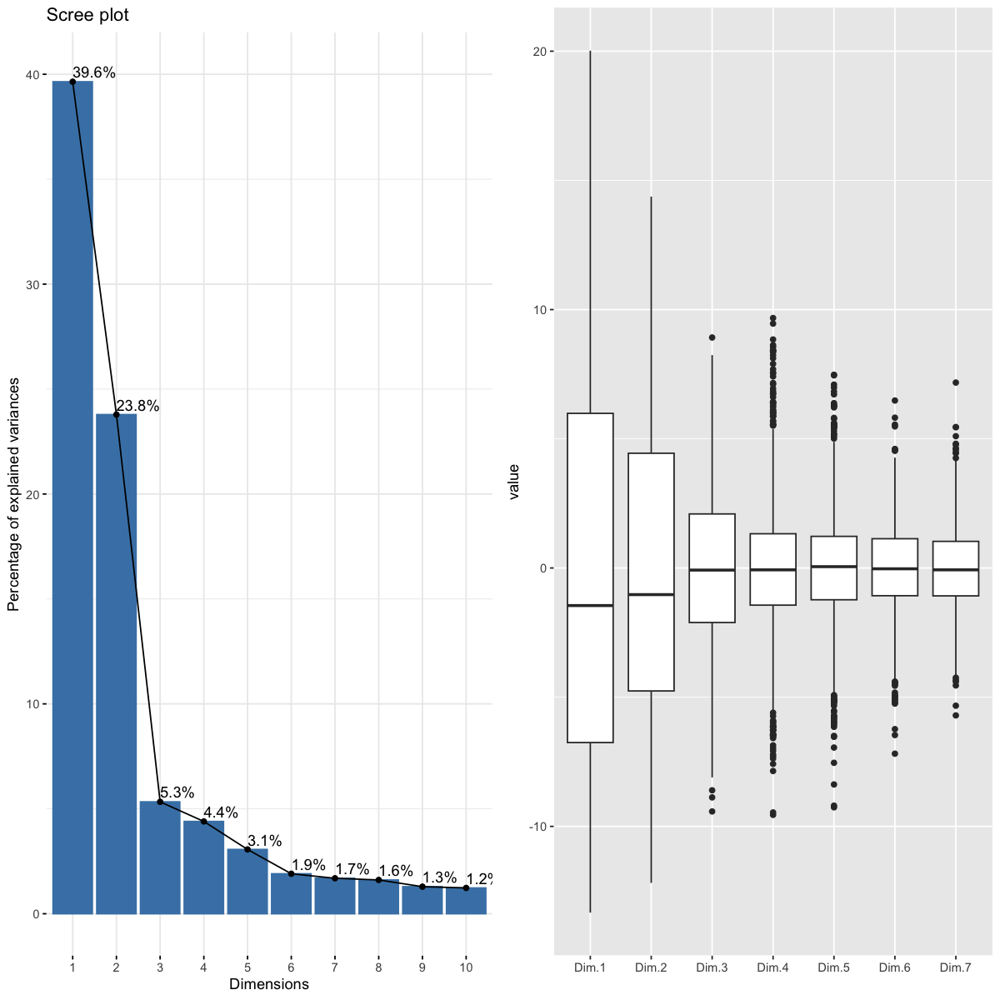

In [423]:
options(repr.plot.width = 10, repr.plot.height = 10)


library(FactoMineR)
acp <- PCA(loading, scale.unit = TRUE,
           graph = FALSE, quali.sup = 1, quanti.sup = 2, ncp = 7)
# Décroissance des valeurs propres
library(factoextra)
g1<-fviz_eig(acp, addlabels = TRUE, ylim = c(0, 40))
library(reshape2)
g2<-ggplot(melt(acp$ind$coord),aes(x=Var2,y=value))+
  geom_boxplot()+
  xlab("")
grid.arrange(g1,g2,ncol=2)

**On constate ainsi que 3 composantes principales nous permettent d'expliquer l'essentiel de la variance.**

**Regardons le cercle des corrélations afin d'analyser les corrélations entre les variables et les composantes principales:**

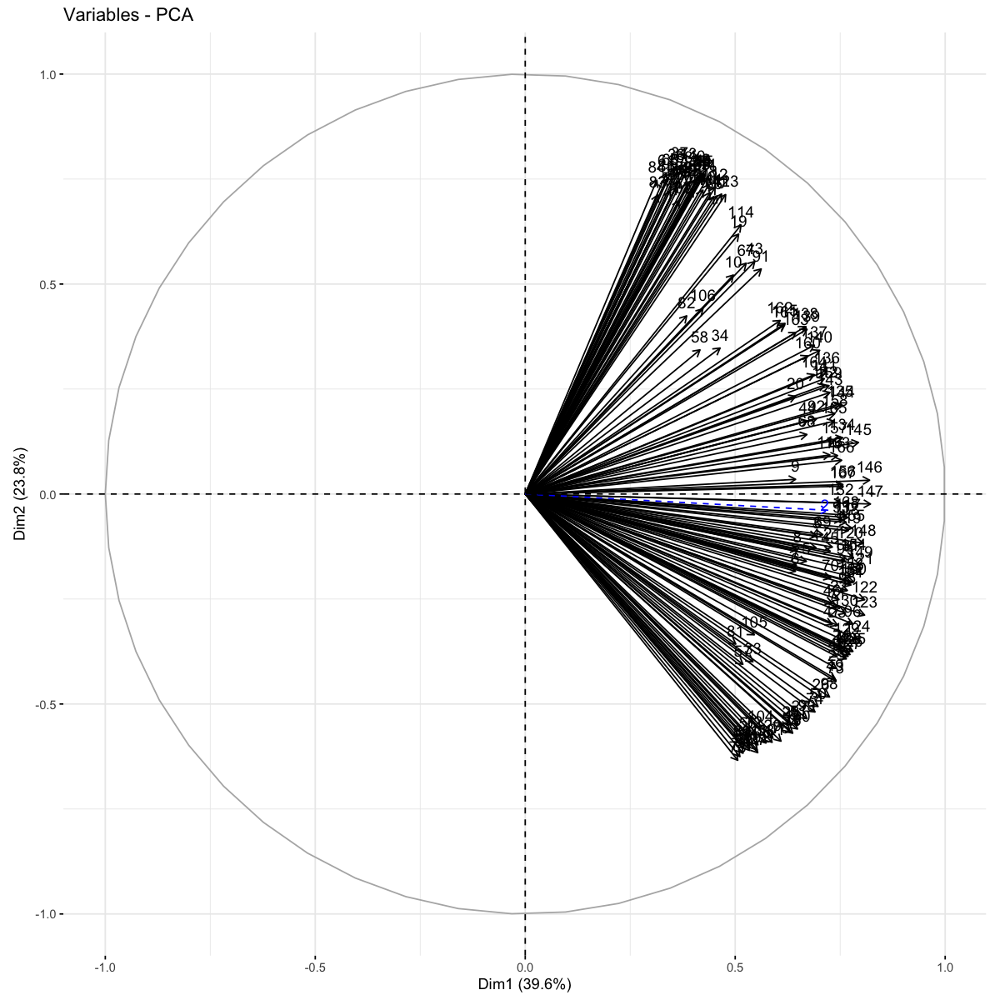

In [424]:
options(repr.plot.width = 10, repr.plot.height = 10)

# Calculer la moyenne de chaque ligne dans la matrice loading
moyenne_loading <- rowMeans(loading, na.rm = TRUE)

# Afficher le vecteur résultant


moyenne_loading_weekend = rowMeans(loading[,120:ncol(loading)] , na.rm=TRUE)



#fviz_pca_var(acp)
#PCA EN FONCTION DE LA MOYENNE DE LOADING SUR TOUTE LA SEMAINE

fviz_pca_var(acp,axes=c(1,2))

**Tous les chargements sont positivements corrélés à la 1ère composante principale. Elle pourrait représenter un niveau de chargement moyen.**

**On affiche le graphe des individus en fonction de la moyenne du chargement sur toute la semaine avec les dimensions 1 et 2 :** 

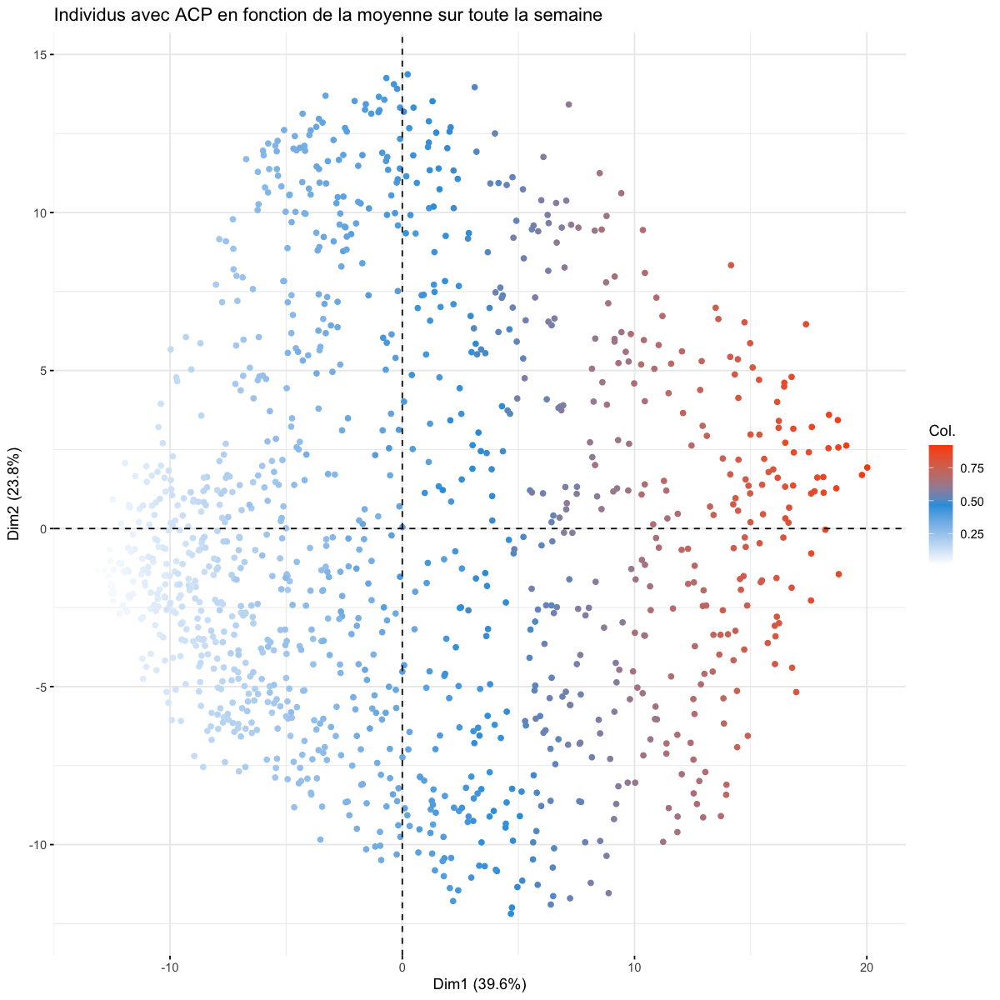

In [425]:
plot2 = fviz_pca_ind(acp,col.ind = moyenne_loading,label="none",gradient.cols = c("white", "#2E9FDF", "#FC4E07" ))
plot2 + ggtitle("Individus avec ACP en fonction de la moyenne sur toute la semaine")

**On remarque que la dimension 1 explique très bien le chargement moyen sur toute la semaine comme pressenti.**

**Ici, on représente le même graphe sauf qu'on le fait par rapport aux dimensions 1 et 3 :**

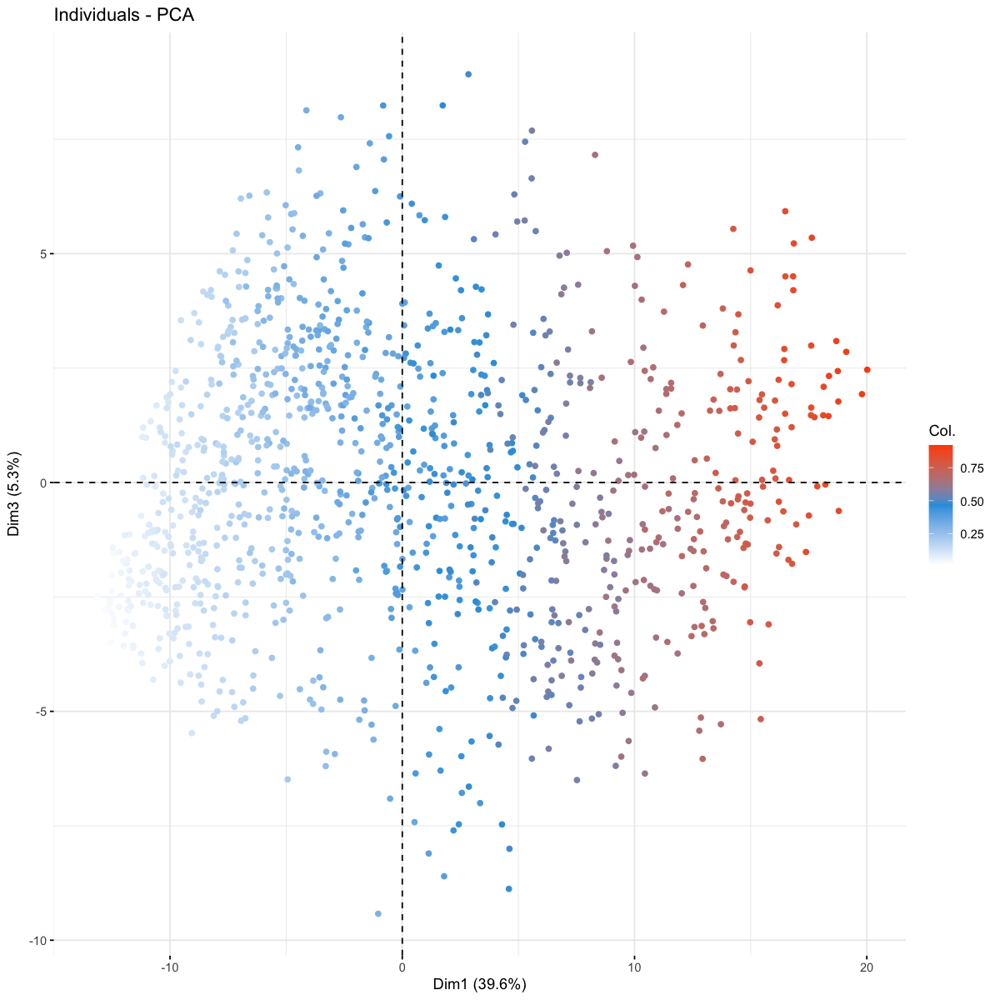

In [426]:
fviz_pca_ind(acp,col.ind = moyenne_loading,label="none",gradient.cols = c("white", "#2E9FDF", "#FC4E07" ),axes=c(1,3))

**Cela confirme le fait que la dimension 1 pourrait correspondre au chargement moyen sur la semaine.**

**Au premier abord, on ne peut pas vraiment interpréter la dimension 2, ainsi nous verrons par la suite comment l'interpréter en utilisant des techniques de clustering.**

## **4. Clustering de nos données**

**Nous allons utiliser plusieurs méthodes de classification afin de regrouper les stations de vélo selon des classes que nous essayerons d'interprêter.**

### **4.1 k-means**

**Le principe du K-means est de regrouper des données en K clusters en minimisant la variance intra-cluster. Initialement, K centroïdes sont placés aléatoirement, puis les données sont assignées au centroïde le plus proche. Les centroïdes sont recalculés comme la moyenne des données assignées, et le processus itère jusqu'à ce que les centroïdes convergent vers des positions stables.**

**Premièrement, déterminons le nombre optimal de cluster par la méthode du score silhouette et du coude.**

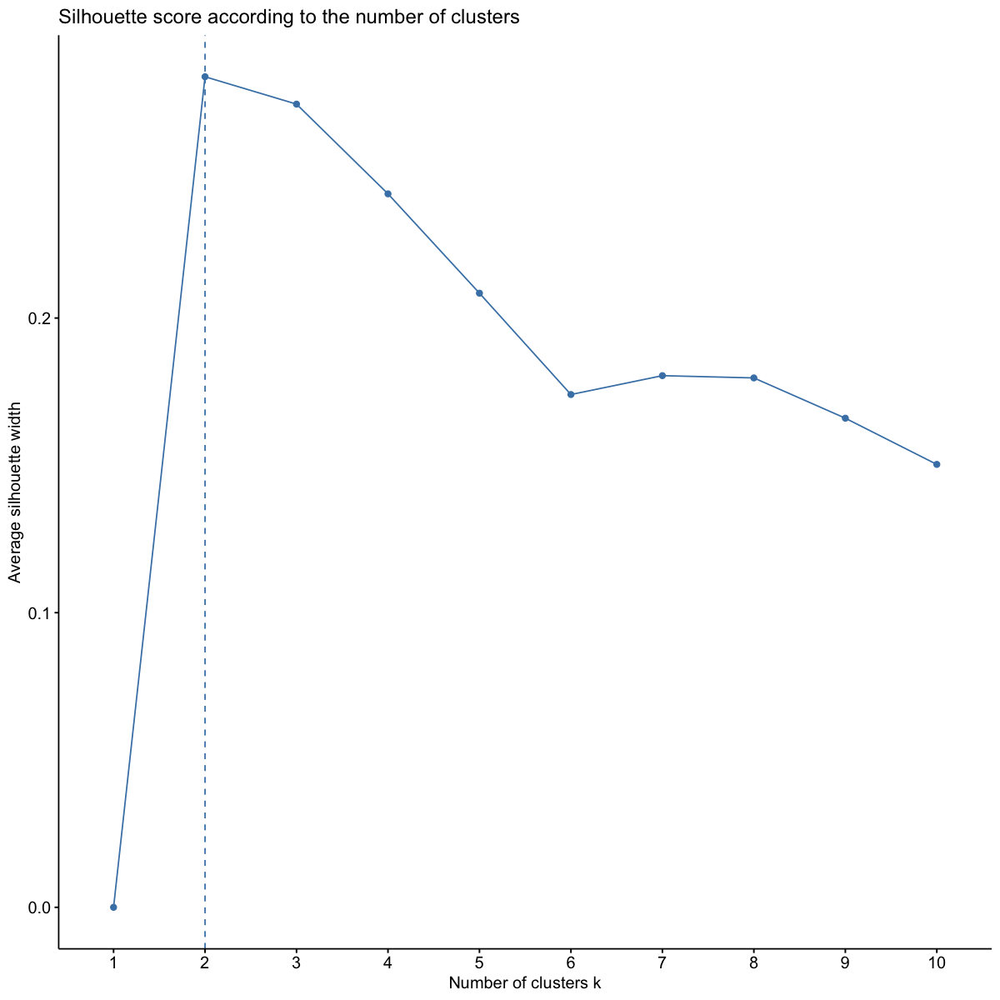

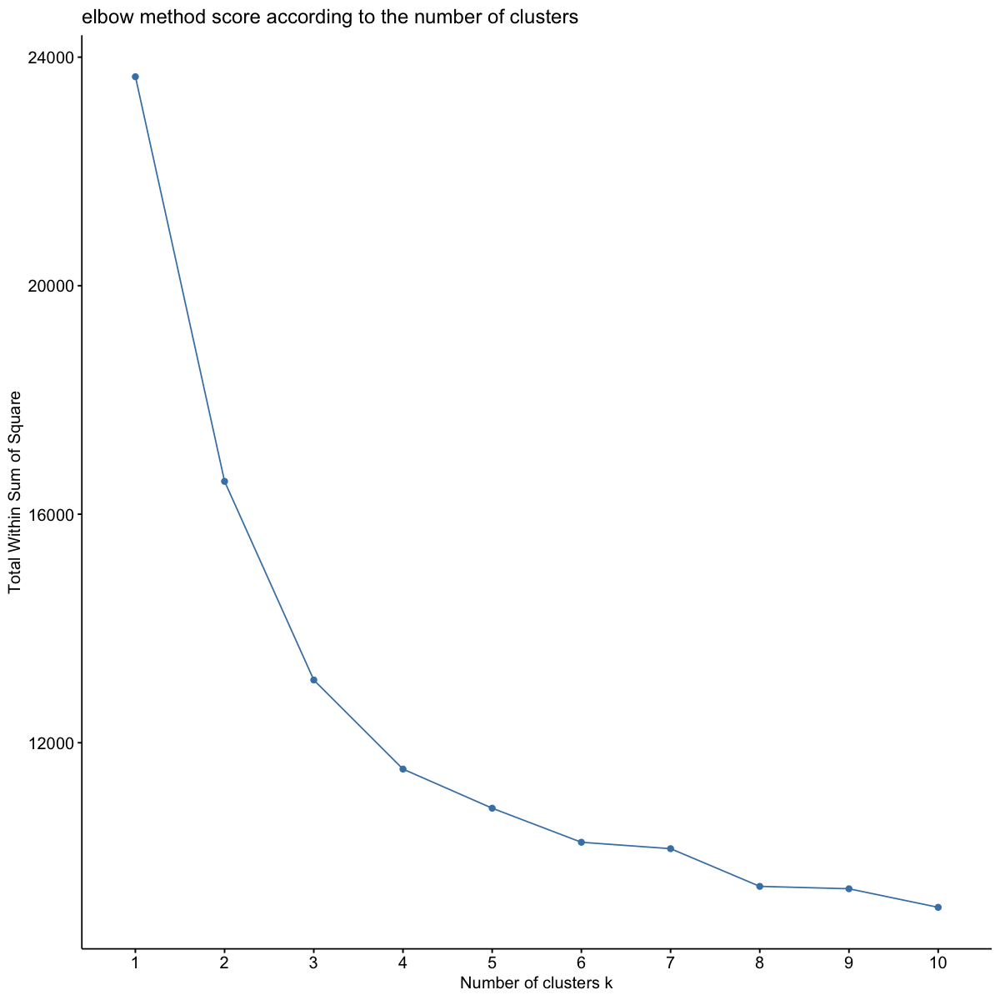

In [427]:
### TO BE COMPLETED ### 
# Elbow method used with silhouette score as metric
options(repr.plot.width = 10, repr.plot.height = 10)
fviz_nbclust(loading, FUNcluster=kmeans, method="silhouette") +
    ggtitle("Silhouette score according to the number of clusters")

fviz_nbclust(loading, FUNcluster=kmeans, method="wss") +
    ggtitle("elbow method score according to the number of clusters")


**D'après le score silhouette, le nombre optimal de clusters est 2. Cependant, d'après la méthode du coude, le nombre optimal est 4.**

**Pour rester cohérent avec nos analyses suivantes, nous allons choisir 4 clusters, donc nous allons utiliser la méthode du coude.**

**Affichons ces clusters sur le graphe des individus pour les dimensions 1 et 2 issues de l'ACP.** 

In [428]:
#clusters = as.factor(reskmeans$cluster)

reskmeans <- kmeans(loading, centers = 4)

options(repr.plot.width = 20, repr.plot.height = 10)

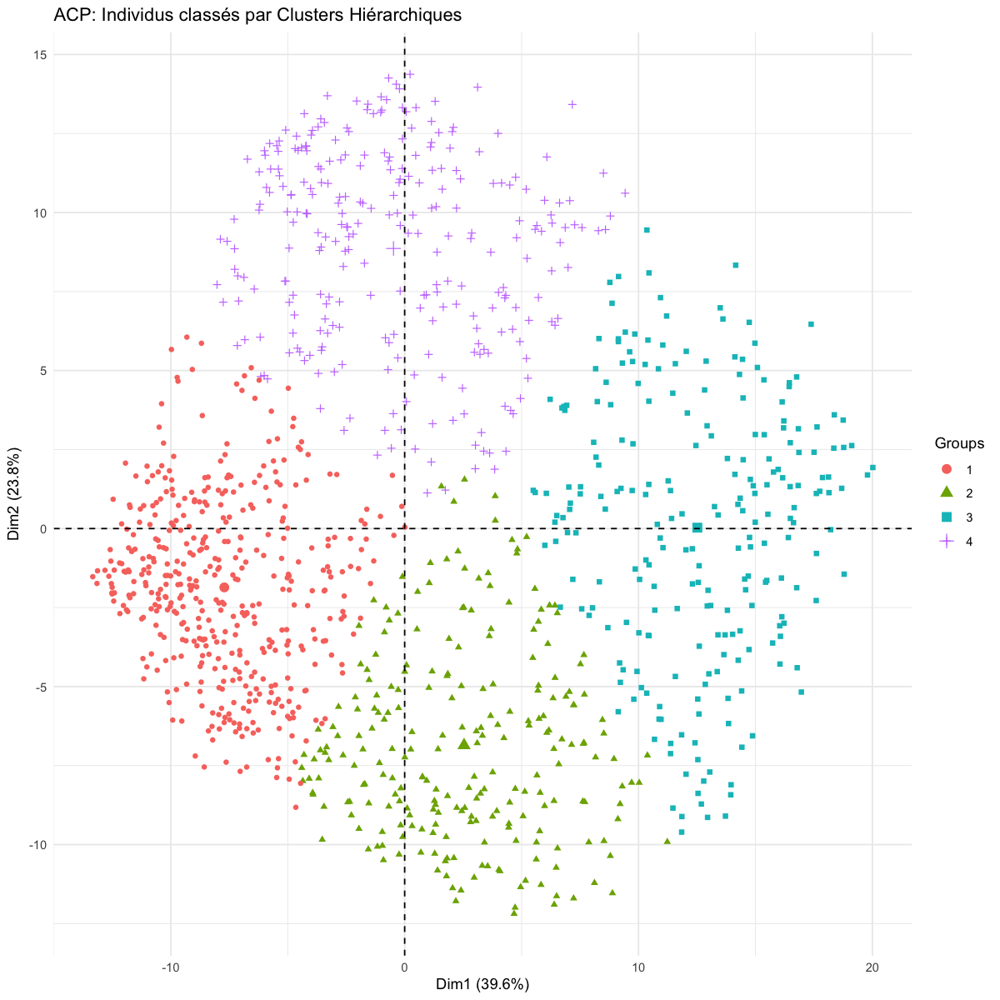

In [429]:
p4 <- fviz_pca_ind(acp, axes = c(1, 2), geom = c("point"), habillage = as.factor(reskmeans$cluster)) +
  labs(title = "ACP: Individus classés par Clusters Hiérarchiques") +
  theme_minimal()
options(repr.plot.width = 10, repr.plot.height = 10)

p4


**Nous voyons ainsi que le cluster droit représente les stations avec un chargement moyen élevé et que le cluster gauche représente les stations avec un chargement moyen faible. Afin d'interpréter les clusters haut et bas (le long de l'axe 2), nous allons afficher le profil de l'individu moyen dans chaque cluster. Cela nous permettra par la même occasion d'interpréter la dimension 2.**

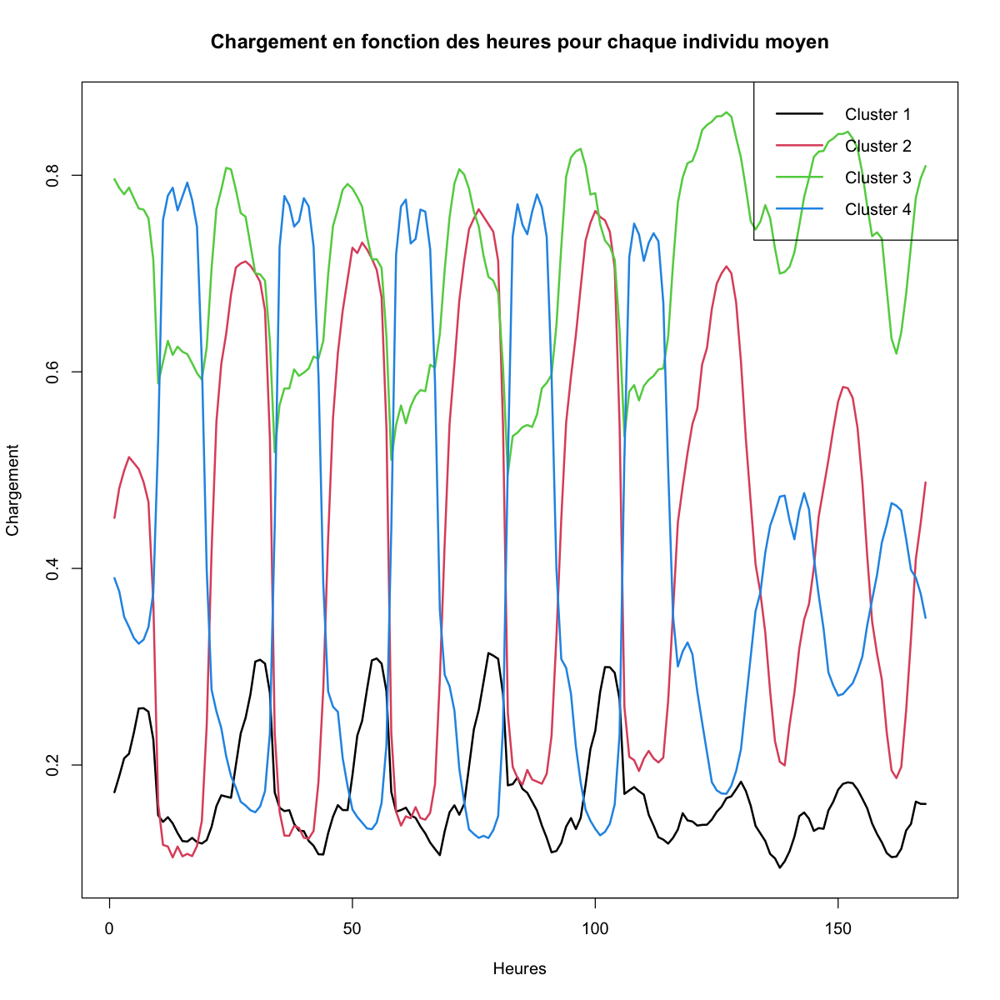

In [430]:
# Création d'une séquence d'heures de 1 à 168
individus_moyens <- reskmeans$centers
heures <- 1:168

# Tracé du chargement en fonction des heures pour chaque individu moyen
matplot(heures, t(individus_moyens), type = "l", xlab = "Heures", ylab = "Chargement", main = "Chargement en fonction des heures pour chaque individu moyen", col = 1:4, lty = 1, lwd = 2)
legend("topright", legend = paste("Cluster", 1:4), col = 1:4, lty = 1, lwd = 2)


**On peut ainsi distinguer que le cluster droit représente les stations les plus chargées et le gauche les stations les moins chargées. De plus, on voit que l'individu moyen du cluster haut est très chargé le jour par rapport à la nuit (sauf les weekends), à l'inverse, l'individu moyen du cluster bas est très chargé la nuit par rapport au jour (sauf les weekends).**

**La composante principale 2 pourrait donc représenter le contraste entre le chargement le jour et le chargement la nuit pendant les jours actifs (hors weekend). Pour le mettre en évidence sur le graphe des individus nous allons calculer un ratio chargement moyen jour hors weekend / chargement nuit hors weekend.**


**Premièrement, regroupons les heures par plage horraire (jour/nuit) de 8h à 20h pour le jour et de 21h à 7h la nuit et calculons la moyenne du chargement sur chaque plage.**

In [431]:
# Créer une nouvelle matrice pour stocker les chargements moyens et les modalités
nb_paquets <- 10
taille_paquet <- 12

chargements_jour_nuit <- matrix(nrow = nrow(loading), ncol = nb_paquets)

# Boucle pour calculer les chargements moyens et affecter les modalités
for (i in 1:nb_paquets) {
  debut <- ifelse(i %% 2 == 1, (i - 1) * taille_paquet + 8, (i - 1) * taille_paquet + 9)
  fin <- ifelse(i %% 2 == 1, i * taille_paquet + 8, (i + 1) * taille_paquet - 5)
  
  # Gestion des heures qui dépassent 24 (passage au jour suivant)
  #debut <- ifelse(debut > 24, debut - 24, debut)
  #fin <- ifelse(fin > 24, fin - 24, fin)
  
    
  # Calcul des chargements moyens et affectation des modalités
  chargements_moyens <- rowMeans(loading[, c(debut:fin)])
  chargements_jour_nuit[, i] <- chargements_moyens
}

# Affichage du chargement qualitatif de la station au cours de la semai
#head(chargements_qualitatifs)

In [432]:
# Calcul de la moyenne des colonnes impaires
moyenne_jour <- rowMeans(chargements_jour_nuit[, seq(1, ncol(chargements_jour_nuit), by = 2)])

# Calcul de la moyenne des colonnes paires
moyenne_nuit <- rowMeans(chargements_jour_nuit[, seq(2, ncol(chargements_jour_nuit), by = 2)])

# Création d'une nouvelle matrice avec deux colonnes correspondant aux moyennes impaires et paires
nouvelles_colonnes <- cbind(moyenne_jour, moyenne_nuit)

# Affichage des nouvelles colonnes
head(nouvelles_colonnes)


moyenne_jour,moyenne_nuit
0.1419837,0.56000481
0.1986622,0.94071146
0.4914026,0.47558750
0.6160813,0.07388167
0.6997646,0.44207045
0.2057692,0.56294466


**On calcule maintenant le ratio jour/nuit:**

In [433]:
ratios_vecteur <- nouvelles_colonnes[, 1] / nouvelles_colonnes[, 2]

print(max(ratios_vecteur))
print(min(ratios_vecteur))

[1] 72.33029
[1] 0.1426777


**Cependant, on remarque que les données ne sont pas toutes à la même échelle, nous allons donc faire une transformation log:**

In [434]:
ratio1 = log(1 + ratios_vecteur)

**On peut ainsi mettre en évidence la dimension 2:**

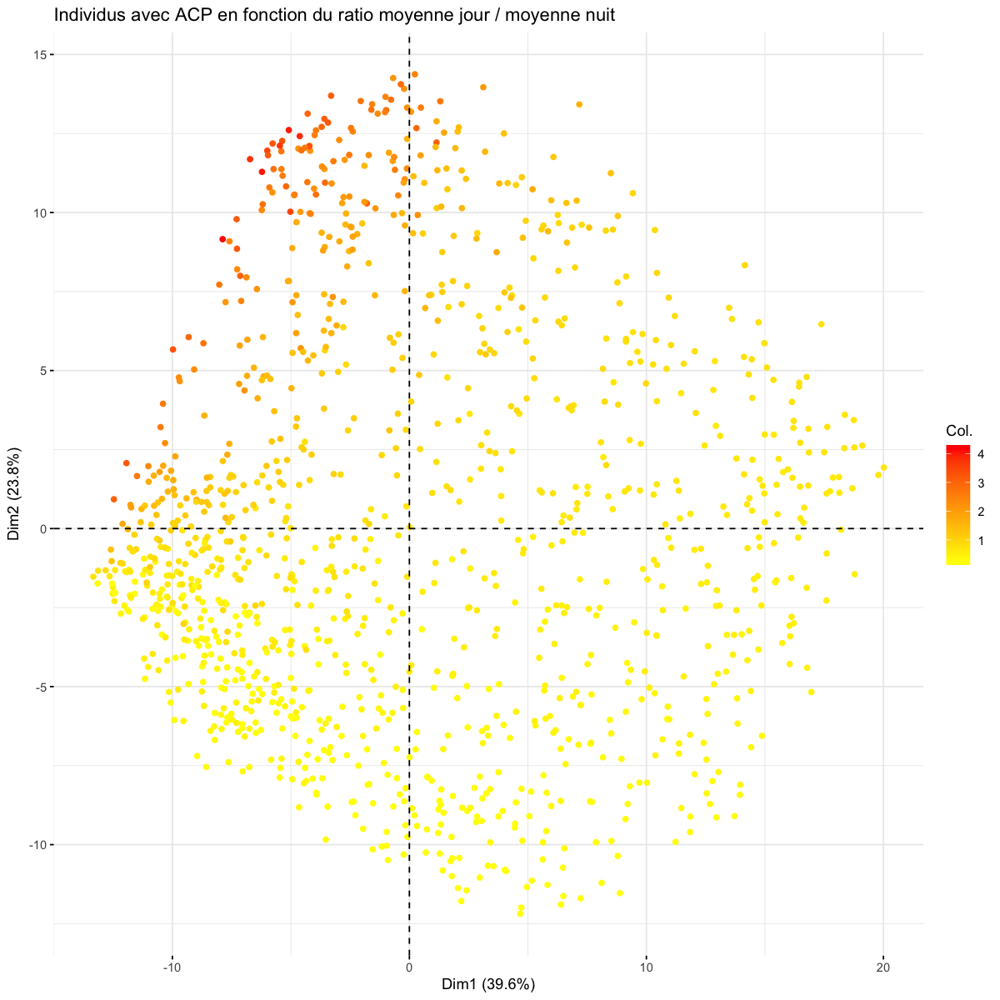

In [435]:
options(repr.plot.width = 10, repr.plot.height = 10)
plot2 <- fviz_pca_ind(acp, col.ind = ratio1, label = "none", gradient.cols = c("yellow", "red"),axes=c(1,2))
plot2 + ggtitle("Individus avec ACP en fonction du ratio moyenne jour / moyenne nuit")



**On conclut donc que la dimension 2 représente bien le contraste entre le chargement le jour et le chargement la nuit pour les jours actifs.**

**Afin de vérifier l'interprétation des clusters de k-means, nous allons représenter les clusters sur la carte de Paris, le chargement moyen sur toute la semaine des stations et le ratio jour/nuit des stations :**

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.



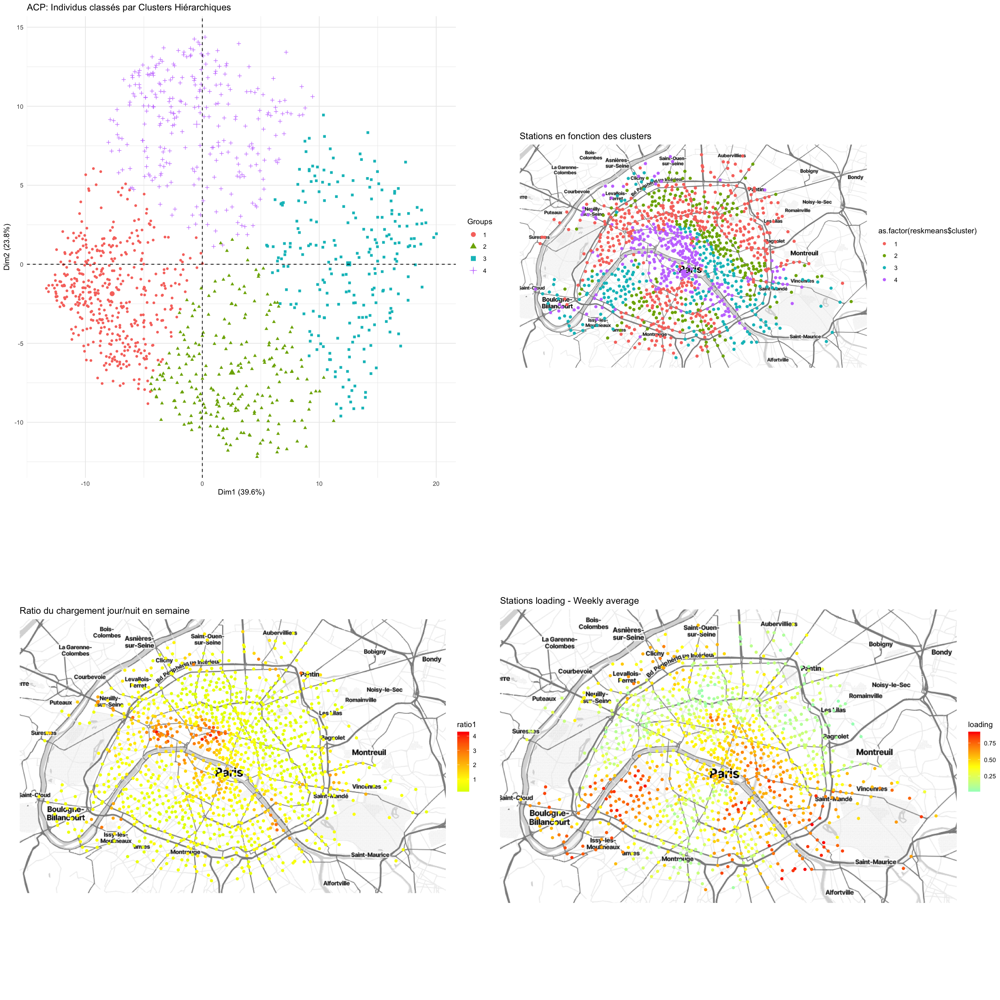

In [436]:
clusters = as.factor(reskmeans$cluster)
df_clusters = df
df_clusters$clusters = clusters

# Graphiques de cartographie et de chargement
p1 <- qmplot(data = df_clusters, longitude, latitude, color = as.factor(reskmeans$cluster)) +
  labs(title = "Stations en fonction des clusters") +
  theme(plot.margin = unit(c(1,1,1,1), "cm"))

# Préparation des autres graphiques avec les données de chargement
p2 <- qmplot(data = df, longitude, latitude, color = ratio1) +
  labs(title = paste('Ratio du chargement jour/nuit en semaine')) +
  scale_color_gradient2(low = "green", mid="yellow", high = "red", midpoint = mean(ratio1)) +
  theme(plot.margin = unit(c(1,1,1,1), "cm"))


h = 18
hours = seq(h, 168, 24)
load_per_hour = rowMeans(loading[, hours])
df$loading = load_per_hour

p3 <- qmplot(data = df, longitude, latitude, color = loading) +
  labs(title = paste('Stations loading - Weekly average at', h, 'h')) +
  scale_color_gradient2(low = "cyan", mid="yellow", high = "red", midpoint = mean(loading)) +
  theme(plot.margin = unit(c(1,1,1,1), "cm"))

# ACP avec habillage par clusters hiérarchiques
#clusters_hclust = as.factor(reshclust)
p4 <- fviz_pca_ind(acp, axes = c(1, 2), geom = c("point"), habillage = as.factor(reskmeans$cluster)) +
  labs(title = "ACP: Individus classés par Clusters Hiérarchiques") +
  theme_minimal()


moyenne_loading <- rowMeans(loading, na.rm = TRUE)

# Créer un nouveau dataframe avec les coordonnées des stations et leur moyenne de chargement
df <- data.frame(longitude = coord$longitude,
                 latitude = coord$latitude,
                 loading = moyenne_loading)

# --- #

options(repr.plot.width = 10, repr.plot.height = 10)

# Utilisez scale_color_gradient2 pour spécifier les couleurs de début et de fin
p5 = qmplot(data = df, longitude, latitude, color = loading) +
  labs(title = 'Stations loading - Weekly average') +
  scale_color_gradient2(low = "cyan", mid = "yellow", high = "red", midpoint = mean(moyenne_loading))


# Organisation des graphiques en grille 2x2
options(repr.plot.width = 20, repr.plot.height = 20)
grid.arrange(p4, p1, p2, p5)


**Ainsi, cela confirme nos interprétations précédentes :**

**- Le cluster gauche représente les stations les moins chargées en moyenne soit les stations excentrées.**

**- Le cluster bas représente les stations plus chargées la nuit par rapport au jour soit les stations proches de zones résidentielles excentrées.**

**- Le cluster droit représente les stations les plus chargées en moyenne soit les stations proches de la Seine.**

**- Le cluster haut représente les stations plus chargées le jour par rapport à la nuit soit les stations proches des zones d'activité le jour.**

### **4.2 CAH**

**Le CAH, ou Classification Ascendante Hiérarchique, est une méthode de clustering qui construit progressivement une hiérarchie de clusters à partir des données. Cette technique commence en traitant chaque observation comme un cluster distinct, puis fusionne progressivement les paires de clusters les plus similaires à chaque étape, formant ainsi une structure d'arbre appelée dendrogramme. Ce processus continue jusqu'à ce que toutes les observations soient regroupées en un seul cluster ou jusqu'à un certain nombre de clusters prédéterminé. Le CAH est particulièrement utile pour visualiser les relations entre les observations et pour identifier des groupements naturels dans les données.**

**Nous allons utiliser la fonction de lien "ward" pour sa capacité à minimiser la variance intra-cluster, formant ainsi des groupes homogènes et bien définis. Elle est idéale pour obtenir des clusters clairs et équilibrés.**

La méthode "ward" a été renommée "ward.D"; notez la nouvelle méthode "ward.D2"



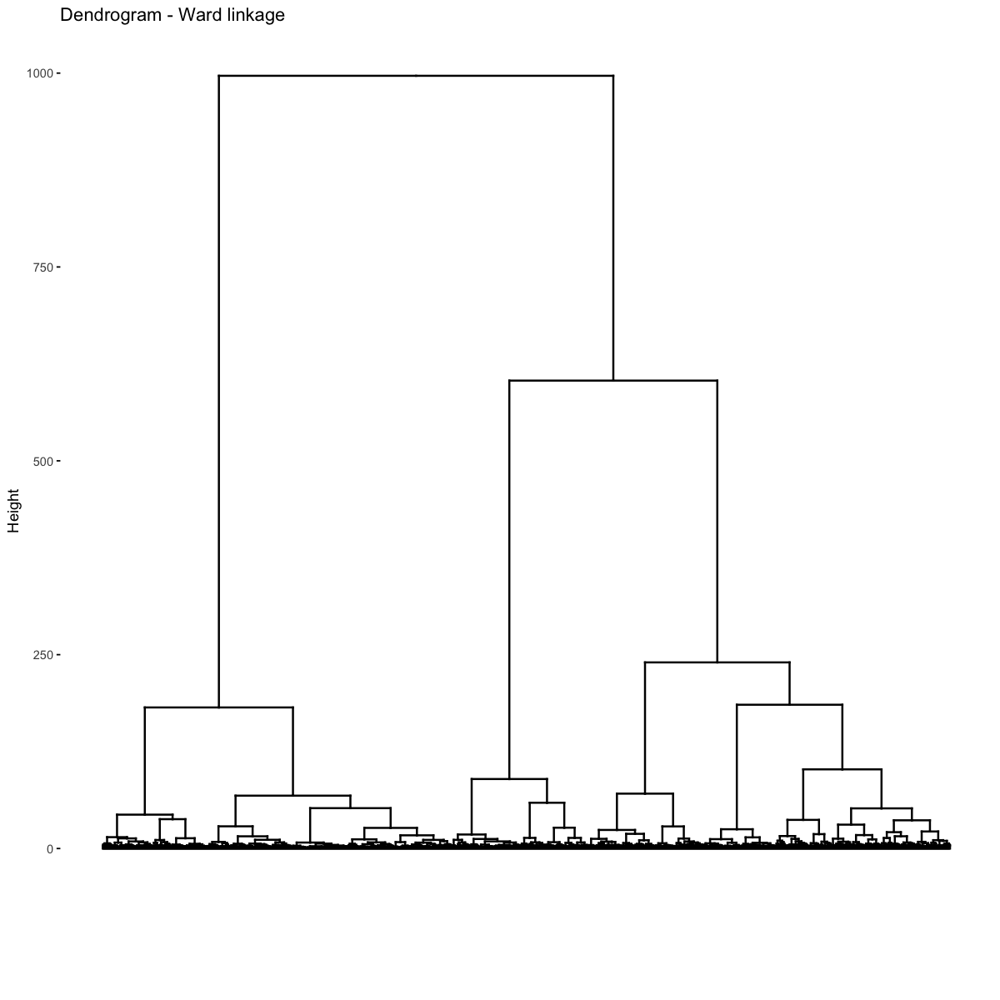

In [437]:
### TO BE COMPLETED ### 

d = dist(loading, method="euclidean")

# Clustering
hclustsingle = hclust(d, method="single")
hclustcomplete = hclust(d, method="complete")
hclustaverage = hclust(d, method="average")

# --- #

#Dendograms visualization
options(repr.plot.width=10, repr.plot.height=10)

#fviz_dend(hclustsingle, show_labels=FALSE, main='Dendrogram - Single linkage')
fviz_dend(hclust(d,method ="ward"), show_labels=FALSE, main='Dendrogram - Ward linkage')
#fviz_dend(hclustaverage, show_labels=FALSE, main='Dendrogram - Average linkage')

**Déterminons le nombre de cluster optimal pour le CAH**

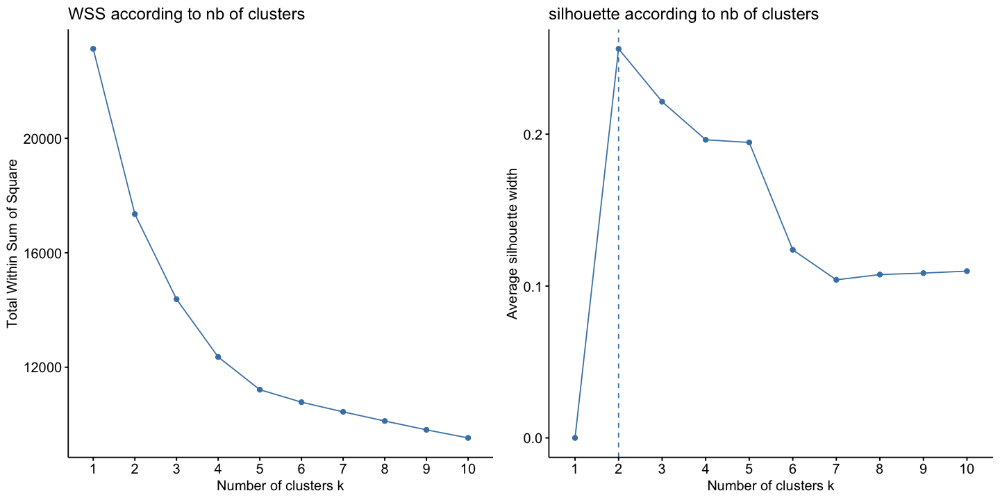

In [438]:
### TO BE COMPLETED ### 
options(repr.plot.width = 12, repr.plot.height = 6)

grid.arrange(
    fviz_nbclust(loading_pas_duplique, FUNcluster=hcut, method="wss") + ggtitle("WSS according to nb of clusters"),
    fviz_nbclust(loading_pas_duplique, FUNcluster=hcut, method="silhouette") + ggtitle("silhouette according to nb of clusters"),
    ncol=2
)


**On peut voir que le score sihlouette nous donne 2, cependant la méthode du coude nous donne 5. Pour faire correspondre nos résultats, nous allons choisir la méthode du coude avec 4 clusters:**

La méthode "ward" a été renommée "ward.D"; notez la nouvelle méthode "ward.D2"

La méthode "ward" a été renommée "ward.D"; notez la nouvelle méthode "ward.D2"



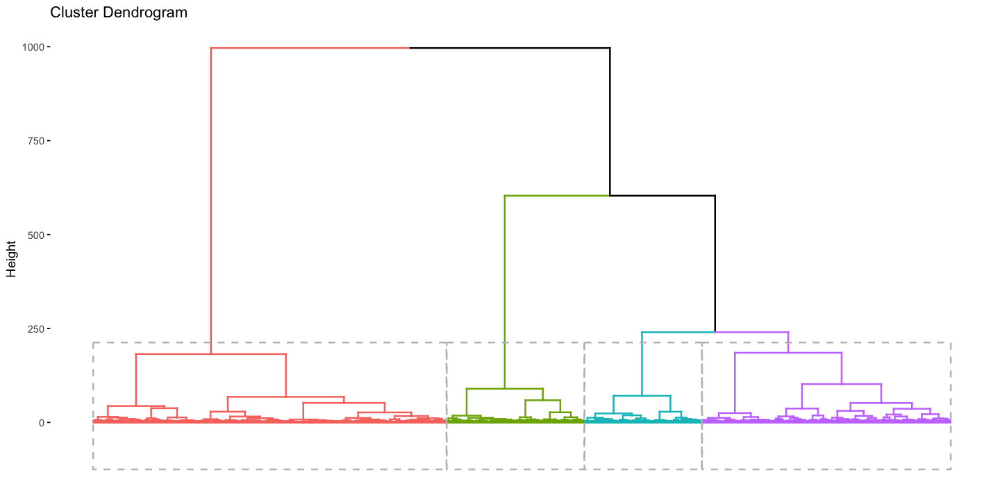

In [439]:
reshclust = cutree(hclust(d,method ="ward"), 4)

# --- #

fviz_dend(hclust(d,method ="ward"), k=4, show_labels=FALSE, rect=TRUE)

**Nous pouvons afficher les clusters sur l'espace de l'ACP et les clusters sur la carte de Paris :**

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.



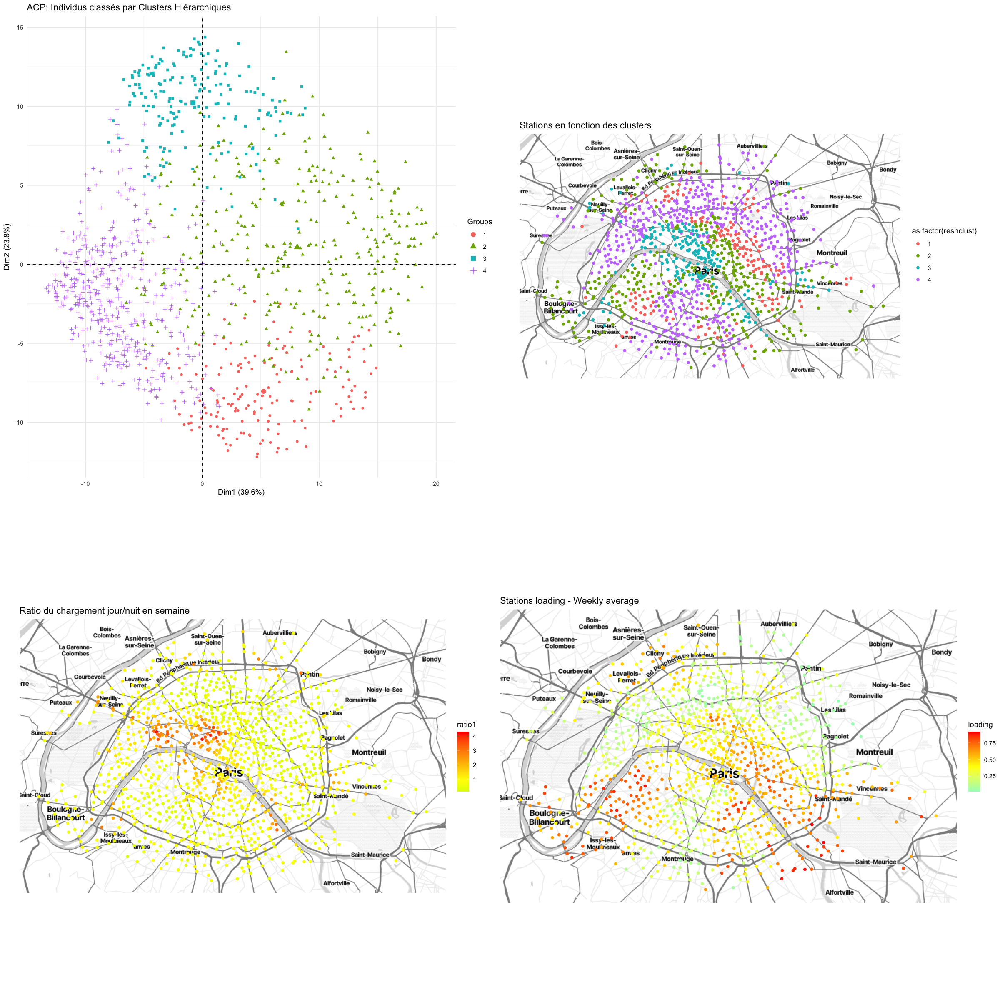

In [440]:

df_clusters = df
df_clusters$clusters = clusters

# Graphiques de cartographie et de chargement
p1 <- qmplot(data = df_clusters, longitude, latitude, color = as.factor(reshclust)) +
  labs(title = "Stations en fonction des clusters") +
  theme(plot.margin = unit(c(1,1,1,1), "cm"))


# ACP avec habillage par clusters hiérarchiques
clusters_hclust = as.factor(reshclust)
p4 <- fviz_pca_ind(acp, axes = c(1, 2), geom = c("point"), habillage = as.factor(reshclust)) +
  labs(title = "ACP: Individus classés par Clusters Hiérarchiques") +
  theme_minimal()


p2 <- qmplot(data = df, longitude, latitude, color = ratio1) +
  labs(title = paste('Ratio du chargement jour/nuit en semaine')) +
  scale_color_gradient2(low = "green", mid="yellow", high = "red", midpoint = mean(ratio1)) +
  theme(plot.margin = unit(c(1,1,1,1), "cm"))

# Utilisez scale_color_gradient2 pour spécifier les couleurs de début et de fin
p5 = qmplot(data = df, longitude, latitude, color = loading) +
  labs(title = 'Stations loading - Weekly average') +
  scale_color_gradient2(low = "cyan", mid = "yellow", high = "red", midpoint = mean(moyenne_loading))



options(repr.plot.width = 10, repr.plot.height = 10)


# Organisation des graphiques en grille 2x2
options(repr.plot.width = 20, repr.plot.height = 20)
grid.arrange(p4, p1,p2,p5)


**Ainsi, nous faisons les mêmes conclusions qu'avec k-means, en effet les clusters semblent à peu près similaires, c'est-à-dire :**

**- Le cluster gauche représente les stations les moins chargées en moyenne soit les stations excentrées.**

**- Le cluster bas représente les stations plus chargées la nuit par rapport au jour soit les stations proches de zones résidentielles excentrées.**

**- Le cluster droit représente les stations les plus chargées en moyenne soit les stations proches de la Seine.**

**- Le cluster haut représente les stations plus chargées le jour par rapport à la nuit soit les stations proches des zones d'activité le jour.**

### **4.3 Comparaison des Méthodes de Clustering**

**Nous allons maintenant comparer les méthodes de clustering à savoir k-means et CAH.**

**Pour commencer, représentons les 2 méthodes de clustering sur l'espace de l'ACP:**

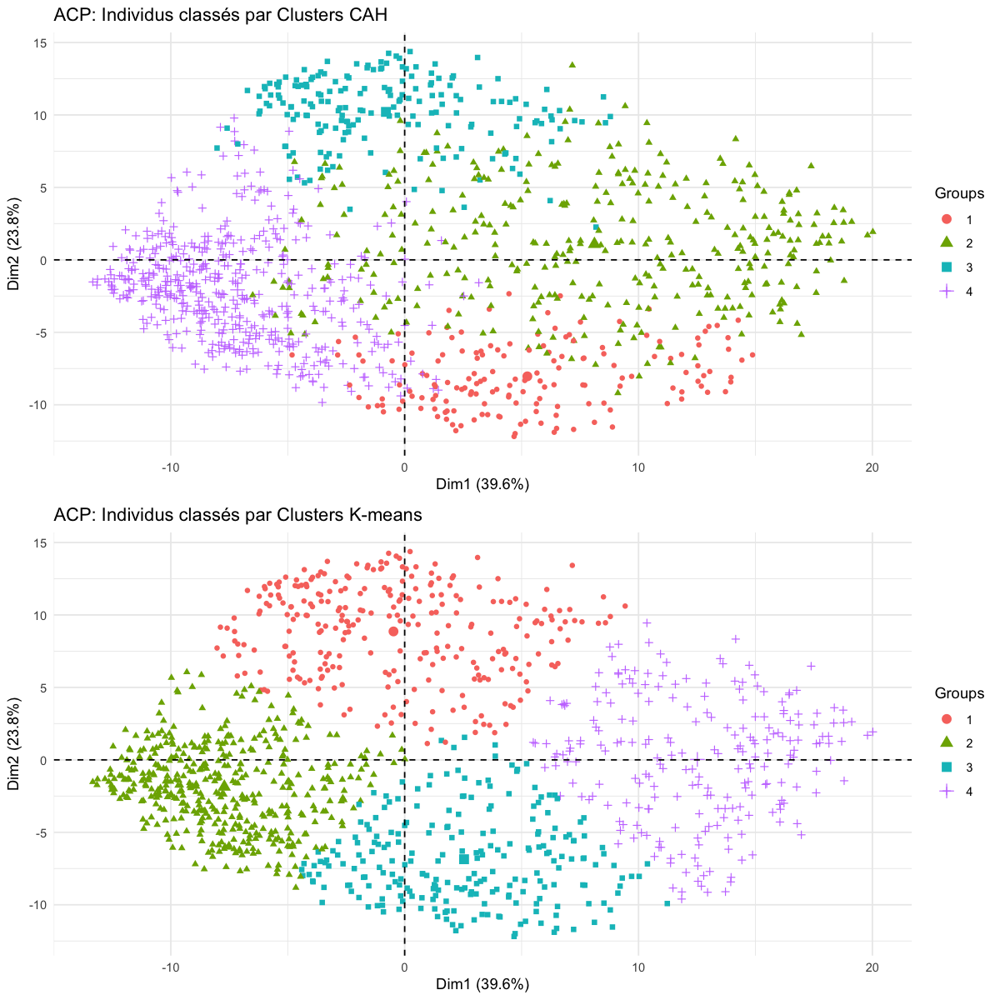

In [441]:
reskmeans <- kmeans(loading, centers = 4)

p1 <- fviz_pca_ind(acp, axes = c(1, 2), geom = c("point"), habillage = as.factor(reshclust)) +
  labs(title = "ACP: Individus classés par Clusters CAH") +
  theme_minimal()




p4 <- fviz_pca_ind(acp, axes = c(1, 2), geom = c("point"), habillage = as.factor(reskmeans$cluster)) +
  labs(title = "ACP: Individus classés par Clusters K-means") +
  theme_minimal()


options(repr.plot.width = 10, repr.plot.height = 10)
grid.arrange(p1, p4)



**On remarque que les clusters sont à peu près les mêmes, cependant on peut remarquer de légères différences entre le cluster droit de CAH et le cluster droit de k-means.**

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.



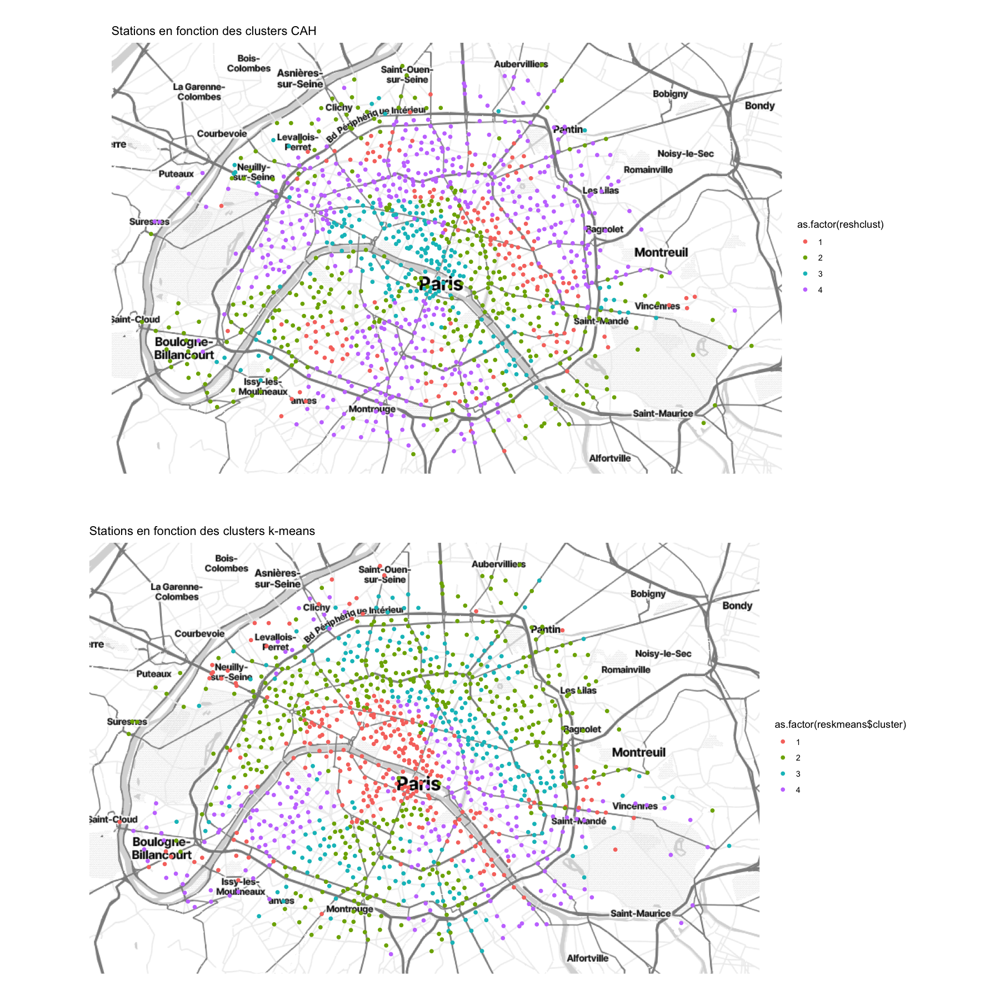

In [442]:
p1 <- qmplot(data = df_clusters, longitude, latitude, color = as.factor(reshclust)) +
  labs(title = "Stations en fonction des clusters CAH") +
  theme(plot.margin = unit(c(1,1,1,1), "cm"))


p2 <- qmplot(data = df_clusters, longitude, latitude, color = as.factor(reskmeans$cluster)) +
  labs(title = "Stations en fonction des clusters k-means") +
  theme(plot.margin = unit(c(1,1,1,1), "cm"))



options(repr.plot.width = 15, repr.plot.height = 15)
grid.arrange(p1, p2)




**En observant, les clusters sur la carte de Paris, on voit que les régions concernées restent globalement les mêmes. Cela nous permet donc de faire une analyse similaire pour k-means et CAH.**

**Pour illustrer, les disparités entre les 2 méthodes construisons la matrice de confusion :**

In [443]:
# Charger les packages nécessaires
if (!require("clue")) install.packages("clue")
if (!require("caret")) install.packages("caret")
library(clue)
library(caret)

# Supposons que `loading` et `d` sont déjà définis et préparés pour le clustering
# `d` devrait être une matrice de distance, nécessaire pour hclust

# Effectuer le clustering hiérarchique
hc <- hclust(d, method = "ward")
clusters_hc <- cutree(hc, k = 4)

# Effectuer le clustering k-means
reskmeans <- kmeans(loading, centers = 4)
clusters_km <- reskmeans$cluster

# Calcul de la matrice de confusion initiale
conf_matrix <- table(clusters_km, clusters_hc)

# Utiliser l'algorithme d'affectation pour trouver la correspondance optimale
best_match <- solve_LSAP(as.matrix(conf_matrix), maximum = TRUE)

# Appliquer l'assignation optimale pour réajuster les étiquettes des clusters de HC
adjusted_clusters_hc <- factor(best_match[clusters_hc])

# Calculer la nouvelle matrice de confusion après la correspondance
new_conf_matrix <- table(clusters_km, adjusted_clusters_hc)

# Afficher la matrice de confusion avec caret pour une belle mise en forme
confusionMatrix(new_conf_matrix, positive = "1")

La méthode "ward" a été renommée "ward.D"; notez la nouvelle méthode "ward.D2"



Confusion Matrix and Statistics

           adjusted_clusters_hc
clusters_km   1   2   3   4
          1   2  31   0 201
          2   0   1 413  27
          3   0 131  56  51
          4 189   0  21  66

Overall Statistics
                                         
               Accuracy : 0.1051         
                 95% CI : (0.0883, 0.124)
    No Information Rate : 0.4121         
    P-Value [Acc > NIR] : 1              
                                         
                  Kappa : -0.1657        
                                         
 Mcnemar's Test P-Value : NA             

Statistics by Class:

                     Class: 1 Class: 2 Class: 3 Class: 4
Sensitivity          0.010471 0.006135   0.1143  0.19130
Specificity          0.767535 0.571150   0.7396  0.75118
Pos Pred Value       0.008547 0.002268   0.2353  0.23913
Neg Pred Value       0.802094 0.783422   0.5436  0.69441
Prevalence           0.160639 0.137090   0.4121  0.29016
Detection Rate       0.001682 0.

**Sur la base de la matrice de confusion et des statistiques fournies, on peut conclure que les classes créées par les méthodes de clustering k-means (KM) et analyse hiérarchique ascendante (CAH) sont à peu près les mêmes dans ce cas. La précision globale du modèle de clustering, mesurée par l'accuracy, est élevée à 78.55%, indiquant une bonne capacité du modèle à classer correctement les observations. De plus, le coefficient Kappa, qui mesure l'accord entre les classifications réelles et prédites, est de 0.7043, ce qui suggère une concordance substantielle entre les deux méthodes.**

**En regardant les statistiques par classe, les sensibilités, spécificités et valeurs prédictives pour chaque classe sont également élevées, indiquant que les deux méthodes ont tendance à classer les mêmes observations dans les mêmes classes. Par conséquent, ces résultats suggèrent que les classes créées par les méthodes de clustering k-means et CAH sont à peu près les mêmes dans ce contexte spécifique.**

# **5. MCA**

**L'Analyse des Correspondances Multiples (MCA) est une technique d'analyse exploratoire des données utilisée pour étudier les relations entre variables catégorielles au sein d'un ensemble de données multivariées. Elle généralise l'Analyse des Correspondances (CA) aux cas où il y a plus de deux variables catégorielles. En MCA, les variables sont projetées dans un espace de faible dimension, où les proximités entre variables et entre individus sont représentées graphiquement, permettant ainsi une visualisation et une interprétation aisées des structures complexes des données catégorielles.**



**Transformons les variables de chargement par heure en variables qualitatives. Nous allons considérer 4 modalités pour le chargement : "Très faible", "Faible", "Moyen", "Élevé".**

In [444]:
assign_modalite <- function(charge_moyenne) {
  if (charge_moyenne < 0.25) {
    return("Très faible")
  } else if (charge_moyenne < 0.5) {
    return("Faible")
  } else if (charge_moyenne < 0.75) {
    return("Moyen")
  } else {
    return("Élevé")
  }
}

# Créer une nouvelle matrice pour stocker les chargements moyens et les modalités
chargements_qualitatifs <- matrix(nrow = nrow(loading), ncol = 42) # 168 heures / 4 heures = 42 paquets de 4 heures

# Boucle pour calculer les chargements moyens et affecter les modalités
for (i in 1:42) {
  debut <- (i - 1) * 4 + 1
  fin <- i * 4
  chargements_moyens <- rowMeans(loading[, debut:fin])
  modalites <- sapply(chargements_moyens, assign_modalite)
  chargements_qualitatifs[, i] <- modalites
}

# Affichage des chargements qualitatifs
# Supposez que vous voulez afficher le chargement qualitatif de la première stationpalette = palette_colors
station <- 1180

# Affichage du chargement qualitatif de la station au cours de la semaine
print(chargements_qualitatifs[station, ])

 [1] "Élevé"       "Élevé"       "Élevé"       "Élevé"       "Moyen"      
 [6] "Faible"      "Faible"      "Moyen"       "Élevé"       "Élevé"      
[11] "Très faible" "Faible"      "Faible"      "Faible"      "Moyen"      
[16] "Faible"      "Très faible" "Très faible" "Très faible" "Faible"     
[21] "Moyen"       "Moyen"       "Moyen"       "Très faible" "Faible"     
[26] "Faible"      "Élevé"       "Élevé"       "Moyen"       "Très faible"
[31] "Très faible" "Faible"      "Faible"      "Très faible" "Très faible"
[36] "Très faible" "Faible"      "Faible"      "Faible"      "Très faible"
[41] "Très faible" "Très faible"


## **5.1 MCA sur des plages jour/nuit et analyse des Hill/No Hill** 

**Afin d'analyser plus précisément l'impact de Hill/No Hill et des alternances jours/nuits, nous allons découper notre jeu de données en 12h : avec la journée de 8h à 20h et la nuit de 21h à 7h.**

In [445]:
# Créer une nouvelle matrice pour stocker les chargements moyens et les modalités
nb_paquets <- 13
taille_paquet <- 12

chargements_qualitatifs <- matrix(nrow = nrow(loading), ncol = nb_paquets)

# Boucle pour calculer les chargements moyens et affecter les modalités
for (i in 1:nb_paquets) {
  debut <- ifelse(i %% 2 == 1, (i - 1) * taille_paquet + 8, (i - 1) * taille_paquet + 9)
  fin <- ifelse(i %% 2 == 1, i * taille_paquet + 8, (i + 1) * taille_paquet - 5)
  
  # Gestion des heures qui dépassent 24 (passage au jour suivant)
  #debut <- ifelse(debut > 24, debut - 24, debut)
  #fin <- ifelse(fin > 24, fin - 24, fin)
  #print(fin)
  # Calcul des chargements moyens et affectation des modalités
  chargements_moyens <- rowMeans(loading[, c(debut:24, 1:fin)])
  modalites <- sapply(chargements_moyens, assign_modalite)
  chargements_qualitatifs[, i] <- modalites
}

# Affichage du chargement qualitatif de la station au cours de la semaine
#print(chargements_qualitatifs[station, ])
#head(chargements_qualitatifs)

In [446]:
chargements_qualitatifs_factor <- as.data.frame(chargements_qualitatifs)
for (i in 1:ncol(chargements_qualitatifs_factor)) {
  chargements_qualitatifs_factor[, i] <- as.factor(chargements_qualitatifs_factor[, i])
}


**Nous affectons des noms cohérents à chaque barycentre de chaque catégorie :**

In [447]:
# Créer un vecteur de noms de colonnes en fonction des périodes
noms_colonnes <- c()

for (i in 1:nb_paquets) {
  debut <- ifelse(i %% 2 == 1, (i - 1) * taille_paquet + 6, (i - 2) * taille_paquet + 19)
  fin <- ifelse(i %% 2 == 1, i * taille_paquet + 6, (i + 1) * taille_paquet - 7)
  

  # Gestion des heures qui dépassent 24 (passage au jour suivant)
  debut <- debut %% 24
  fin <- fin %% 24
  #print(debut)
  # Calcul du numéro du jour
  jour <- ceiling(i / 2)
  
  # Construction du nom de la période avec le numéro du jour, l'heure et l'indication nuit/jour
  if (debut < fin) {
    nom_periode <- paste0("Jour_", jour, "_")
  } else {
    nom_periode <- paste0("Nuit_", jour, "_")
  }
  
  # Ajouter le nom de la période au vecteur de noms de colonnes
  noms_colonnes <- c(noms_colonnes, nom_periode)
}

# Assigner les noms de colonnes à la matrice chargements_qualitatifs
colnames(chargements_qualitatifs) <- noms_colonnes



In [448]:
chargements_qualitatifs_factor <- as.data.frame(chargements_qualitatifs)
for (i in 1:ncol(chargements_qualitatifs_factor)) {
  chargements_qualitatifs_factor[, i] <- as.factor(chargements_qualitatifs_factor[, i])
}


**On ajoute la variable "Bonus" qui correspond à Hill/No Hill (la station se trouve sur une colline ou non :**

In [449]:
chargements_qualitatifs_factor$hill = as.factor(coord$bonus)
levels(chargements_qualitatifs_factor$hill) = c('No hill','Hill')

**Enfin, affichons notre jeu de données transformé en variables qualitatives :**

In [450]:
head(chargements_qualitatifs_factor)

,Jour_1_,Nuit_1_,Jour_2_,Nuit_2_,Jour_3_,Nuit_3_,Jour_4_,Nuit_4_,Jour_5_,Nuit_5_,Jour_6_,Nuit_6_,Jour_7_,hill
,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>
1,Très faible,Très faible,Très faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,No hill
2,Faible,Moyen,Moyen,Moyen,Moyen,Moyen,Moyen,Moyen,Moyen,Moyen,Moyen,Moyen,Moyen,No hill
3,Faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,No hill
4,Élevé,Moyen,Moyen,Faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,No hill
5,Élevé,Moyen,Moyen,Moyen,Moyen,Moyen,Moyen,Moyen,Moyen,Moyen,Moyen,Moyen,Moyen,No hill
6,Très faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,Faible,No hill


**On affiche enfin la MCA :**

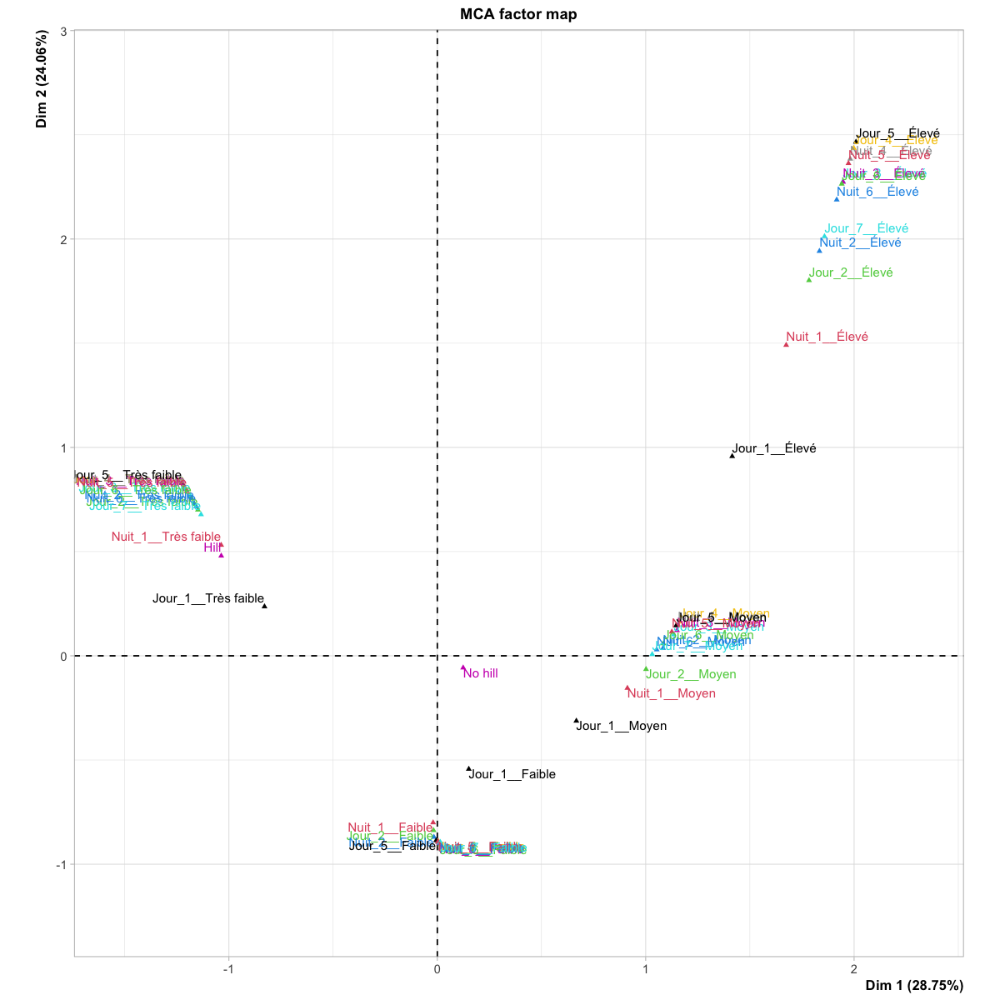

In [451]:
library(FactoMineR)


 options(repr.plot.width = 10, repr.plot.height = 10)

# Effectuer l'analyse MCA
mca <- MCA(chargements_qualitatifs_factor, graph = FALSE)

# Afficher le graphe des individus
plot(mca, invisible = "ind", habillage = "quali", cex = 0.8)


**Premièrement, on peut remarquer que la composante principale 1 explique le chargement moyen comme lors de l'ACP**

**On peut aussi remarquer que les stations situées sur des collines sont bien moins chargées que les stations non situées sur des collines, cela est probablement du au fait que les stations sur des collines sont plus difficiles d'accès.**



### **5.1.1 Clustering (k-means) sur la MCA (jour/nuit)**

**Nous allons maintenant faire du clustering sur notre MCA, afin d'avoir une analyse plus poussée des composantes principales de la MCA.**

In [452]:

# Obtenir les coordonnées des individus dans l'espace MCA
coord_mca <- as.data.frame(mca$ind$coord)

# Appliquer K-means sur l'espace MCA
kmeans_result <- kmeans(coord_mca, centers = 4)

# Afficher les résultats du clustering
#print(kmeans_result)

# Visualiser les clusters dans l'espace MCA avec fviz_mclust
#fviz_mclust(kmeans_result, geom = "point", data = coord_mca)


**Nous pouvons regarder le nombre optimal de cluster en utilisant la méthode du score silhouette et la méthode du coude :**

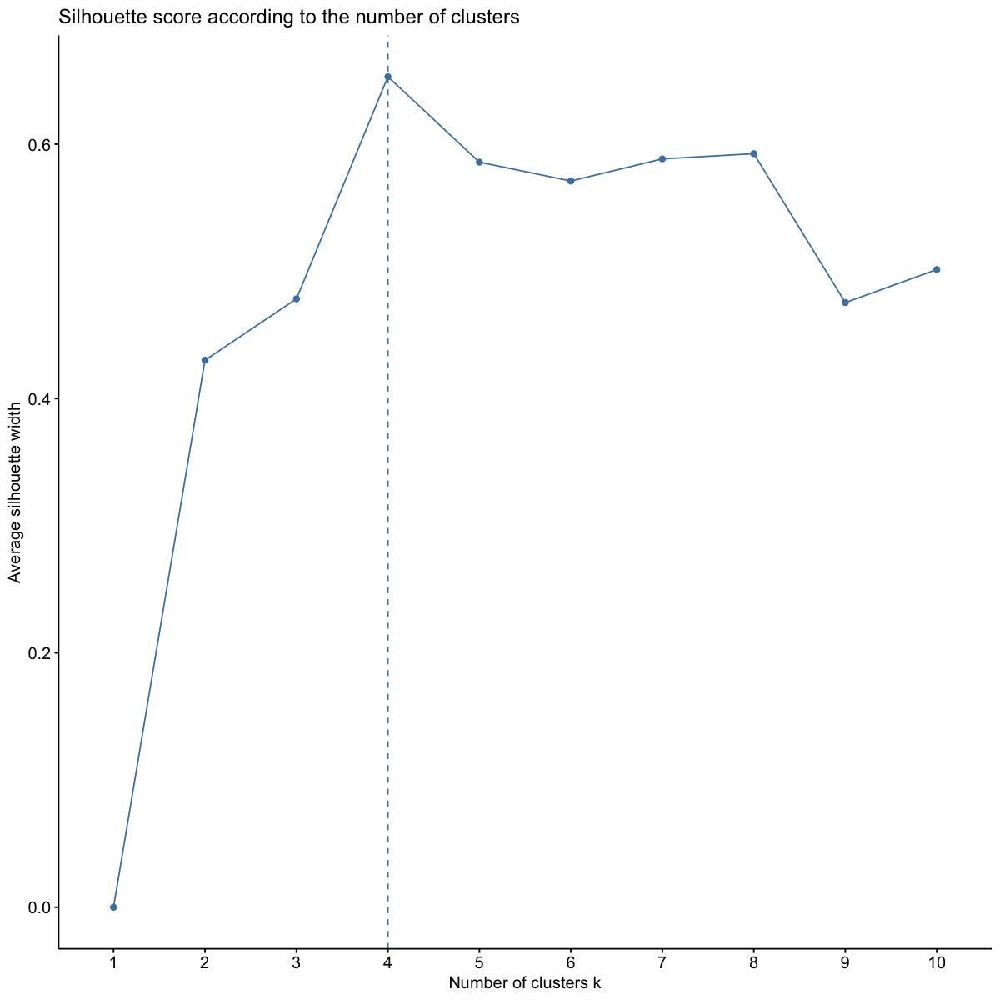

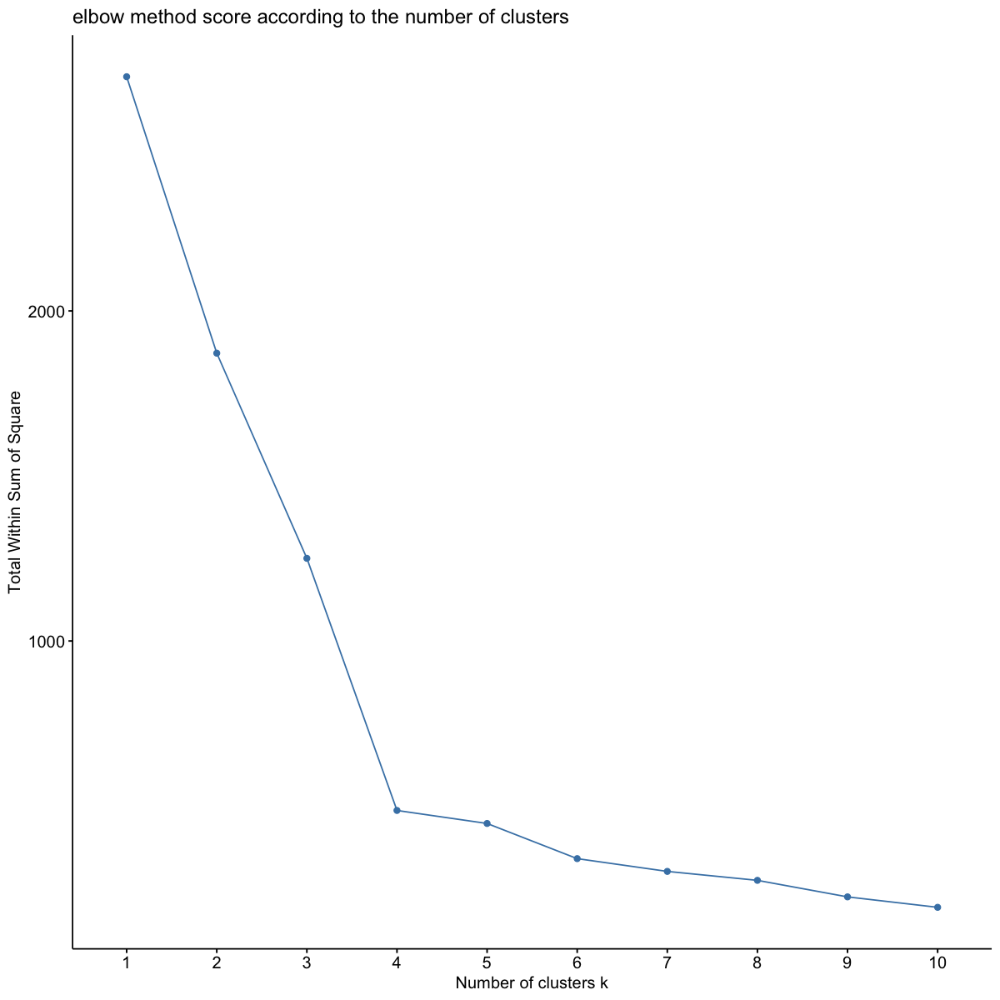

In [453]:
### TO BE COMPLETED ### 
# Elbow method used with silhouette score as metric

 options(repr.plot.width = 10, repr.plot.height = 10)

fviz_nbclust(coord_mca, FUNcluster=kmeans, method="silhouette") +
    ggtitle("Silhouette score according to the number of clusters")

fviz_nbclust(coord_mca, FUNcluster=kmeans, method="wss") +
    ggtitle("elbow method score according to the number of clusters")


**Nous remarquons que le nombre optimal de clusters pour les 2 méthodes est 4, nous allons donc choisir 4 clusters :**

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.



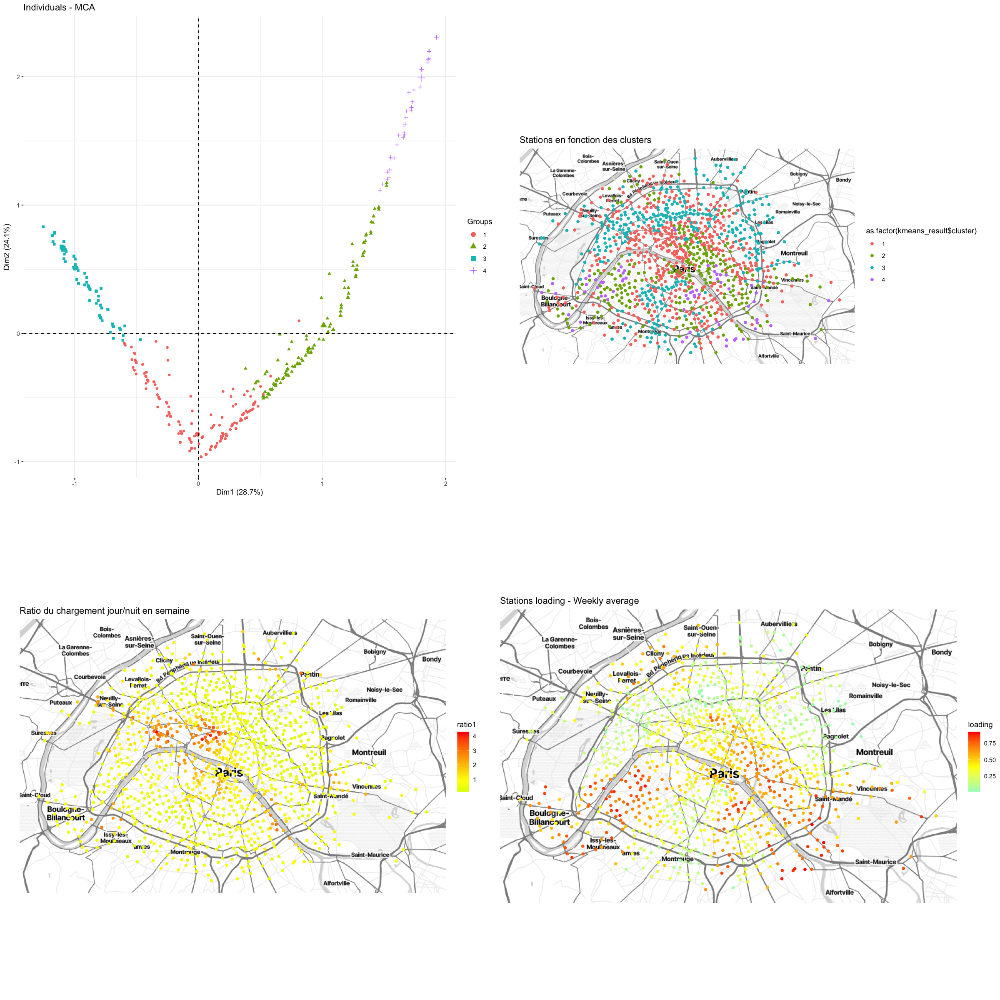

In [454]:
options(repr.plot.width = 20, repr.plot.height = 20)

p1 = fviz_pca_ind(mca, axes=c(1,2), geom=c("point"), habillage=as.factor(kmeans_result$cluster))


p2 = qmplot(data = df_clusters, longitude, latitude, color = as.factor(kmeans_result$cluster)) +
  labs(title = "Stations en fonction des clusters") +
  theme(plot.margin = unit(c(1,1,1,1), "cm"))



p3 <- qmplot(data = df, longitude, latitude, color = ratio1) +
  labs(title = paste('Ratio du chargement jour/nuit en semaine')) +
  scale_color_gradient2(low = "green", mid="yellow", high = "red", midpoint = mean(ratio1)) +
  theme(plot.margin = unit(c(1,1,1,1), "cm"))

p5 = qmplot(data = df, longitude, latitude, color = loading) +
  labs(title = 'Stations loading - Weekly average') +
  scale_color_gradient2(low = "cyan", mid = "yellow", high = "red", midpoint = mean(moyenne_loading))









grid.arrange(p1,p2,p3,p5)

**Avec ces représentations, nous pouvons ainsi remarquer que le cluster le plus à droite (sur l'espace de la MCA) et le cluster à droite correspondent aux stations les plus chargées en moyenne.**

**À l'inverse, les clusters à gauche et au centre correspondent aux stations les moins chargées.**

**Cependant, concernant la dimension 2, nous n'arrivons pas clairement à identifier une tendance.**

## 5.2 MCA sur des plages de 4h

**Nous allons faire maintenant des plages de 4h pour être plus précis afin d'observer une évolution en fonction de la journée :**

In [455]:
# Créer une nouvelle matrice pour stocker les chargements moyens et les modalités
nb_paquets <- 42
taille_paquet <- 4

chargements_qualitatifs <- matrix(nrow = nrow(loading), ncol = nb_paquets)

# Boucle pour calculer les chargements moyens et affecter les modalités
for (i in 1:nb_paquets) {
  debut <- (i - 1) * taille_paquet + 1
  fin <- i * taille_paquet
  chargements_moyens <- rowMeans(loading[, debut:fin])
  modalites <- sapply(chargements_moyens, assign_modalite)
  chargements_qualitatifs[, i] <- modalites

}

# Affichage du chargement qualitatif de la station au cours de la semaine
#print(chargements_qualitatifs[station, ])

In [456]:
chargements_qualitatifs_factor <- as.data.frame(chargements_qualitatifs)
for (i in 1:ncol(chargements_qualitatifs_factor)) {
  chargements_qualitatifs_factor[, i] <- as.factor(chargements_qualitatifs_factor[, i])
}


In [457]:
chargements_qualitatifs_factor$hill = as.factor(coord$bonus)
levels(chargements_qualitatifs_factor$hill) = c('No hill','Hill')

**On affiche la MCA :**

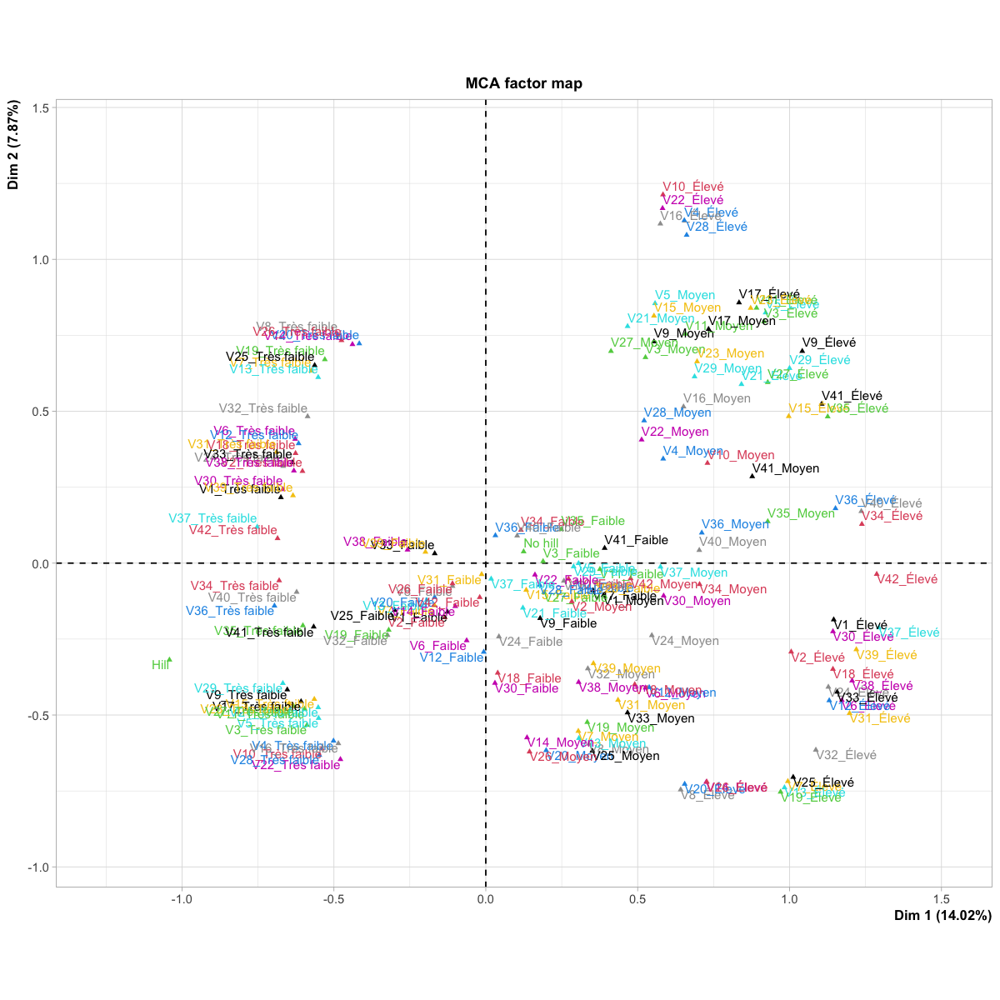

In [458]:
library(FactoMineR)

options(repr.plot.width = 10, repr.plot.height = 10)


# Effectuer l'analyse MCA
mca <- MCA(chargements_qualitatifs_factor, graph = FALSE)

# Afficher le graphe des individus
plot(mca, invisible = "ind", habillage = "quali", cex = 0.8)


**On voit que les stations situées sur des collines sont généralement peu chargées. Alors que les stations non situées sur des collines sont moyennement chargées.**

### **5.2.1 Clustering (k-means) sur la MCA (plage de 4h)**

**Nous allons maintenant faire du clustering sur notre MCA, afin d'avoir une analyse plus poussée des composantes principales de la MCA.**

In [459]:
# Installer et charger le package FactoMineR si ce n'est pas déjà fait

library(FactoMineR)

# Installer et charger le package factoextra pour fviz_mclust

library(factoextra)

# Effectuer l'Analyse des Correspondances Multiples (MCA) sur les chargements qualitatifs
mca <- MCA(chargements_qualitatifs_factor)

# Obtenir les coordonnées des individus dans l'espace MCA
coord_mca <- as.data.frame(mca$ind$coord)

# Appliquer K-means sur l'espace MCA
kmeans_result <- kmeans(coord_mca, centers = 4)

# Afficher les résultats du clustering
#print(kmeans_result)

# Visualiser les clusters dans l'espace MCA avec fviz_mclust
#fviz_mclust(kmeans_result, geom = "point", data = coord_mca)


**Nous pouvons regarder le nombre optimal de cluster en utilisant la méthode du score silhouette et la méthode du coude :**

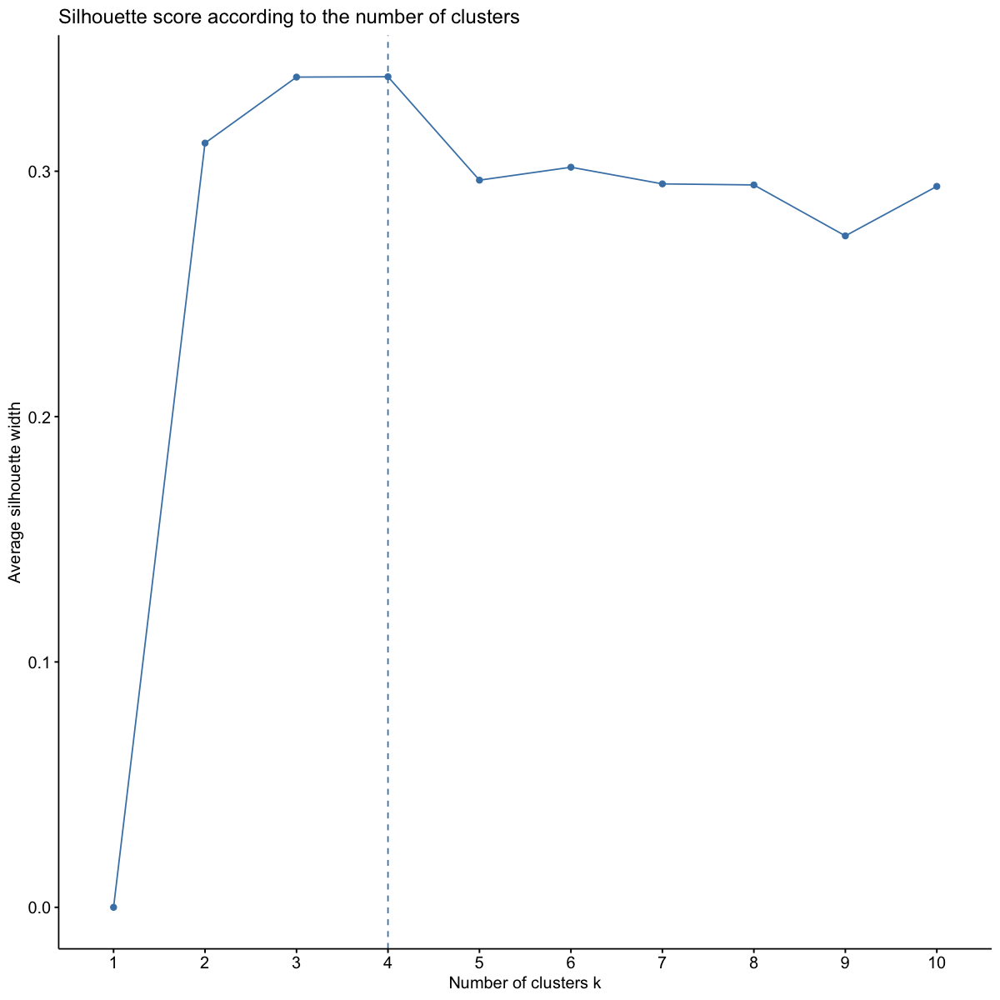

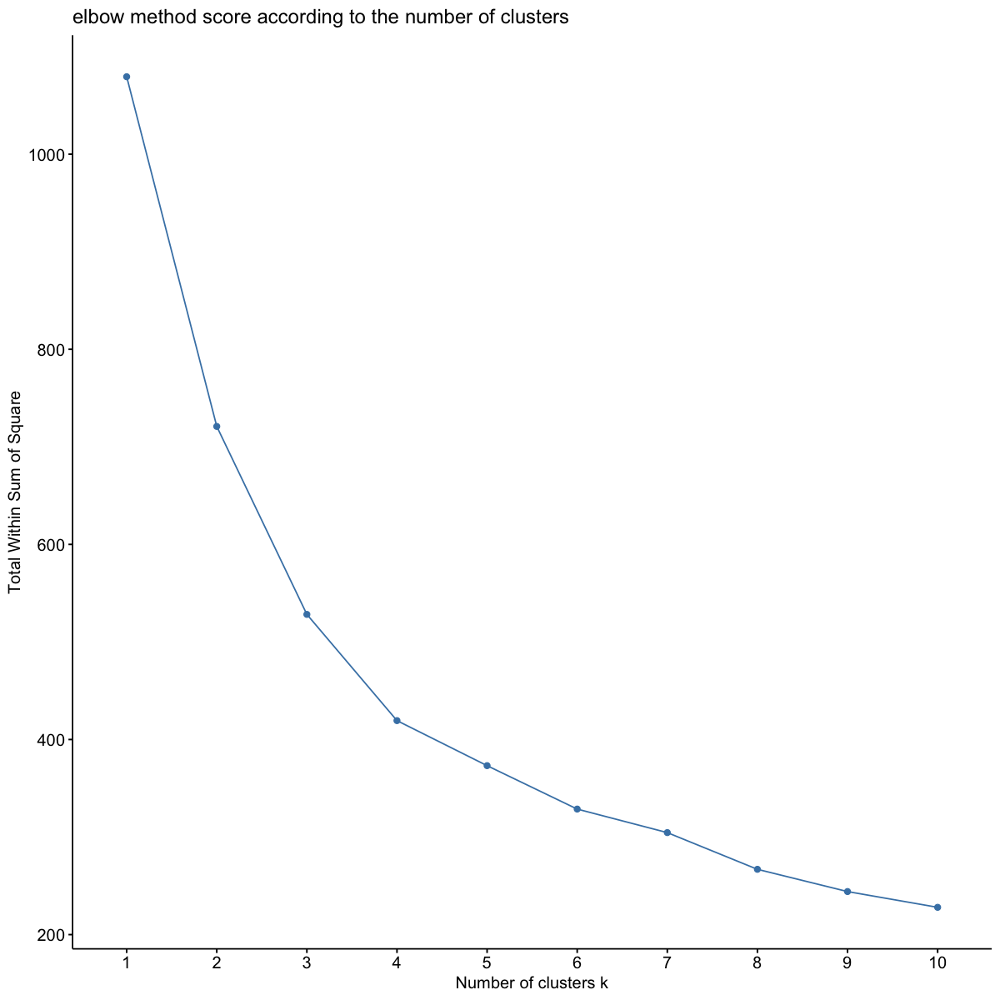

In [460]:
### TO BE COMPLETED ### 
# Elbow method used with silhouette score as metric
options(repr.plot.width = 10, repr.plot.height = 10)
fviz_nbclust(coord_mca, FUNcluster=kmeans, method="silhouette") +
    ggtitle("Silhouette score according to the number of clusters")

fviz_nbclust(coord_mca, FUNcluster=kmeans, method="wss") +
    ggtitle("elbow method score according to the number of clusters")


**Nous remarquons que le nombre optimal de clusters pour les 2 méthodes est 4, nous allons donc choisir 4 clusters :**

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.



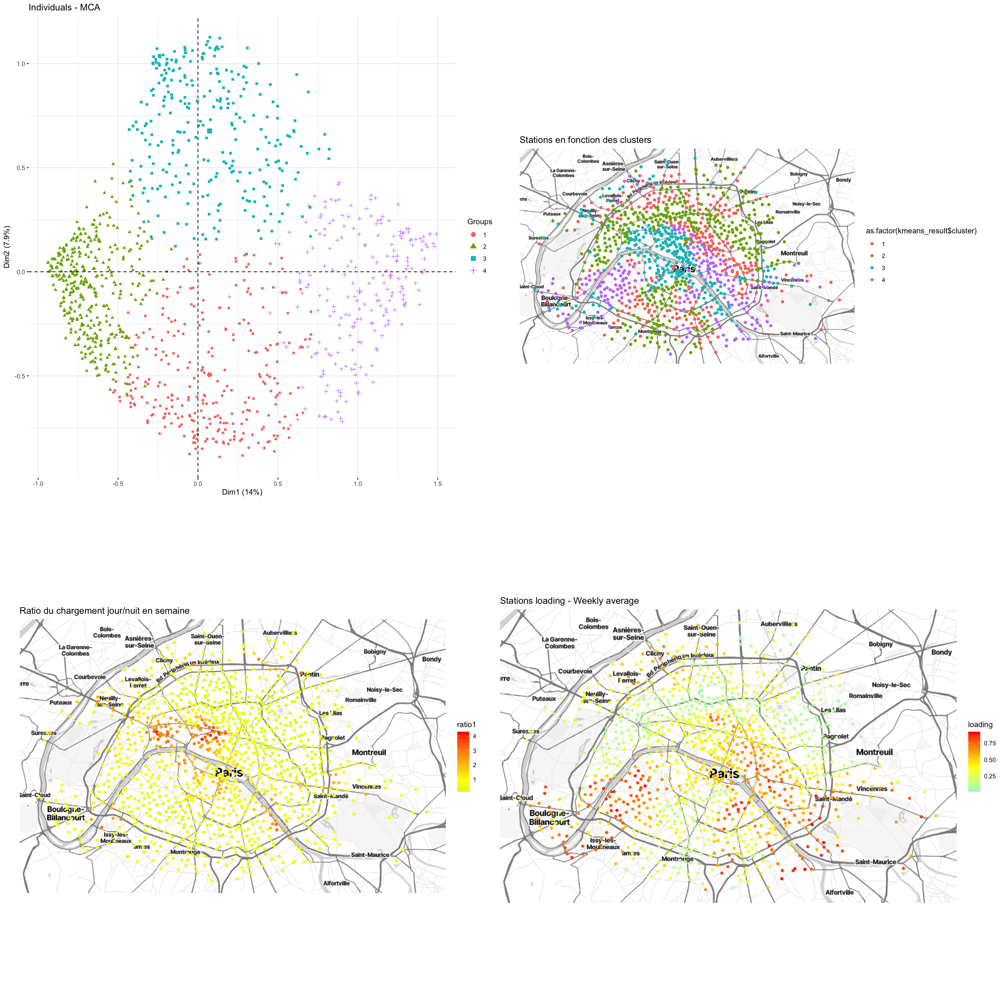

In [461]:
options(repr.plot.width = 20, repr.plot.height = 20)

p1 = fviz_pca_ind(mca, axes=c(1,2), geom=c("point"), habillage=as.factor(kmeans_result$cluster))


p2 = qmplot(data = df_clusters, longitude, latitude, color = as.factor(kmeans_result$cluster)) +
  labs(title = "Stations en fonction des clusters") +
  theme(plot.margin = unit(c(1,1,1,1), "cm"))



p3 <- qmplot(data = df, longitude, latitude, color = ratio1) +
  labs(title = paste('Ratio du chargement jour/nuit en semaine')) +
  scale_color_gradient2(low = "green", mid="yellow", high = "red", midpoint = mean(ratio1)) +
  theme(plot.margin = unit(c(1,1,1,1), "cm"))

p5 = qmplot(data = df, longitude, latitude, color = loading) +
  labs(title = 'Stations loading - Weekly average') +
  scale_color_gradient2(low = "cyan", mid = "yellow", high = "red", midpoint = mean(moyenne_loading))









grid.arrange(p1,p2,p3,p5)

**On remarque que les clusters sont sensiblement les mêmes que sur l'ACP, on peut donc faire les mêmes interprétations, à savoir :**

**- Le cluster gauche représente les stations les moins chargées en moyenne soit les stations excentrées.**

**- Le cluster bas représente les stations plus chargées la nuit par rapport au jour soit les stations proches de zones résidentielles excentrées.**

**- Le cluster droit représente les stations les plus chargées en moyenne soit les stations proches de la Seine.**

**- Le cluster haut représente les stations plus chargées le jour par rapport à la nuit soit les stations proches des zones d'activité le jour.**

## Conclusion

En résumé, notre analyse des données Velib révèle des tendances distinctes dans la distribution des vélos entre les stations. Les regroupements identifiés par différentes méthodes de clustering confirment la cohérence des profils de chargement des stations, comme le suggère également l'analyse en composantes principales (ACP). De plus, la cohérence observée entre l'ACP et l'analyse factorielle multiple (MCA) renforce nos conclusions et confirme la validité de nos hypothèses initiales.